# Imports

In [1]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from scipy.stats import zscore
from pandas_profiling import ProfileReport

from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.tree import export_graphviz, DecisionTreeClassifier
from sklearn.manifold import TSNE

from umap import UMAP

import sompy
from sompy.visualization.mapview import View2D
from sompy.visualization.bmuhits import BmuHitsView
from sompy.visualization.hitmap import HitMapView

import graphviz
import pydotplus

%matplotlib inline
%config InlineBackend.figure_format = "retina"

sns.set()

import logging 
logger = logging.getLogger() 
logger.setLevel(logging.CRITICAL)

deprecate positional args: graphviz.backend.piping.pipe(['renderer', 'formatter', 'quiet'])
deprecate positional args: graphviz.backend.rendering.render(['renderer', 'formatter', 'quiet'])
deprecate positional args: graphviz.backend.unflattening.unflatten(['stagger', 'fanout', 'chain', 'encoding'])
deprecate positional args: graphviz.backend.viewing.view(['quiet'])
deprecate positional args: graphviz.quoting.quote(['is_html_string', 'is_valid_id', 'dot_keywords', 'escape_unescaped_quotes'])
deprecate positional args: graphviz.quoting.a_list(['kwargs', 'attributes'])
deprecate positional args: graphviz.quoting.attr_list(['kwargs', 'attributes'])
deprecate positional args: graphviz.dot.Dot.clear(['keep_attrs'])
deprecate positional args: graphviz.dot.Dot.__iter__(['subgraph'])
deprecate positional args: graphviz.dot.Dot.node(['_attributes'])
deprecate positional args: graphviz.dot.Dot.edge(['_attributes'])
deprecate positional args: graphviz.dot.Dot.attr(['_attributes'])
deprecate positi

# Reading

In [2]:
data = pd.read_sas("./a2z_insurance.sas7bdat")
data.head()

,CustID,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
0,1.0,1985.0,1982.0,b'2 - High School',2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89
1,2.0,1981.0,1995.0,b'2 - High School',677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13
2,3.0,1991.0,1970.0,b'1 - Basic',2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02
3,4.0,1990.0,1981.0,b'3 - BSc/MSc',1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34
4,5.0,1986.0,1973.0,b'3 - BSc/MSc',1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45


# Metadata

- *CustID* - Unique identifier of the customer
- *FirstPolYear* - Year of the customer’s first policy
- *BirthYear* - Customer’s birth year
- *EducDeg* - Academic degree
- *MonthSal* - Gross monthly salary
- *GeoLivArea* - Living area
- *Children* - Binary variable (0 or 1)
- *CustMonVal* - Customer Monetary Value
- *ClaimsRate* - Claims rate
- *PremMotor*, *PremHousehold*, *PremHealth*, *PremLife*, *PremWork* - Premiums in LOB

# Preprocessing

## Profiling before

In [3]:
profile = ProfileReport(
    data, 
    title='Customer Data',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": False},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },
)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Filling missing values

In [4]:
data.dtypes

CustID           float64
FirstPolYear     float64
BirthYear        float64
EducDeg           object
MonthSal         float64
GeoLivArea       float64
Children         float64
CustMonVal       float64
ClaimsRate       float64
PremMotor        float64
PremHousehold    float64
PremHealth       float64
PremLife         float64
PremWork         float64
dtype: object

In [5]:
data.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
CustID,10296.0,NaN,NaN,NaN,5148.5,2972.34352,1.0,2574.75,5148.5,7722.25,10296.0
FirstPolYear,10266.0,NaN,NaN,NaN,1991.062634,511.267913,1974.0,1980.0,1986.0,1992.0,53784.0
BirthYear,10279.0,NaN,NaN,NaN,1968.007783,19.709476,1028.0,1953.0,1968.0,1983.0,2001.0
EducDeg,10279,4,b'3 - BSc/MSc',4799,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MonthSal,10260.0,NaN,NaN,NaN,2506.667057,1157.449634,333.0,1706.0,2501.5,3290.25,55215.0
GeoLivArea,10295.0,NaN,NaN,NaN,2.709859,1.266291,1.0,1.0,3.0,4.0,4.0
Children,10275.0,NaN,NaN,NaN,0.706764,0.455268,0.0,0.0,1.0,1.0,1.0
CustMonVal,10296.0,NaN,NaN,NaN,177.892605,1945.811505,-165680.42,-9.44,186.87,399.7775,11875.89
ClaimsRate,10296.0,NaN,NaN,NaN,0.742772,2.916964,0.0,0.39,0.72,0.98,256.2
PremMotor,10262.0,NaN,NaN,NaN,300.470252,211.914997,-4.11,190.59,298.61,408.3,11604.42


In [6]:
metric_features = [
    "FirstPolYear",
    "BirthYear",
    "MonthSal",
    "CustMonVal",
    "ClaimsRate",
    "PremMotor",
    "PremHousehold",
    "PremHealth",
    "PremLife",
    "PremWork",
]
non_metric_features = [
    "EducDeg",
    "GeoLivArea",
    "Children",
]

In [7]:
data_central = data.copy()

In [8]:
data_central.isna().sum()

CustID             0
FirstPolYear      30
BirthYear         17
EducDeg           17
MonthSal          36
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        43
PremLife         104
PremWork          86
dtype: int64

In [9]:
medians = data_central[metric_features].median()
medians

FirstPolYear     1986.00
BirthYear        1968.00
MonthSal         2501.50
CustMonVal        186.87
ClaimsRate          0.72
PremMotor         298.61
PremHousehold     132.80
PremHealth        162.81
PremLife           25.56
PremWork           25.67
dtype: float64

In [10]:
modes = data_central[non_metric_features].mode().loc[0]
modes

EducDeg       b'3 - BSc/MSc'
GeoLivArea               4.0
Children                 1.0
Name: 0, dtype: object

In [11]:
data_central.fillna(medians, inplace=True)
data_central.fillna(modes, inplace=True)
data_central.isna().sum()

CustID           0
FirstPolYear     0
BirthYear        0
EducDeg          0
MonthSal         0
GeoLivArea       0
Children         0
CustMonVal       0
ClaimsRate       0
PremMotor        0
PremHousehold    0
PremHealth       0
PremLife         0
PremWork         0
dtype: int64

In [12]:
data = data_central.copy()

## Removing outliers

### Manual filtering

In [13]:
data_manual = data.copy()

In [14]:
filters = (
    (data["FirstPolYear"] >= 1850.0) & (data["FirstPolYear"] <= 2006.0) &
    (data["BirthYear"] >= 1850.0) & (data["BirthYear"] <= 2006.0) &
    (data["MonthSal"] >= 0.0) & (data["MonthSal"] <= 10000.0) &
    (data["CustMonVal"] >= -10000.0) & (data["CustMonVal"] <= 10000.0)
)
data_manual = data[filters]

In [15]:
print("Percentage of data kept after removing outliers:", 100 * np.round(data_manual.shape[0] / data.shape[0], 4))

Percentage of data kept after removing outliers: 99.86


In [16]:
data = data_manual.copy()

### Z-score filtering

In [17]:
data_zscore = data.copy()

In [18]:
zscores = zscore(data[metric_features])
filters = (np.abs(zscores) < 3).all(axis=1)
data_zscore = data[filters]

In [19]:
print("Percentage of data kept after removing outliers:", 100 * np.round(data_zscore.shape[0] / data.shape[0], 4))

Percentage of data kept after removing outliers: 95.8


In [20]:
data = data_zscore.copy()

## Type casting

In [21]:
data["CustID"] = data["CustID"].astype("int64")
data["FirstPolYear"] = data["FirstPolYear"].astype("int64")
data["BirthYear"] = data["BirthYear"].astype("int64")
data["EducDeg"] = data["EducDeg"].astype("str")
data["GeoLivArea"] = data["GeoLivArea"].astype("int64")
data["Children"] = data["Children"].astype("int64")

In [22]:
data.set_index("CustID", inplace=True)
data_interpretable = data.copy()
data.head()

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
1,1985,1982,b'2 - High School',2177.0,1,1,380.97,0.39,375.85,79.45,146.36,47.01,16.89
3,1991,1970,b'1 - Basic',2277.0,3,0,504.67,0.28,206.15,224.50,124.58,86.35,99.02
4,1990,1981,b'3 - BSc/MSc',1099.0,4,1,-16.99,0.99,182.48,43.35,311.17,35.34,28.34
5,1986,1973,b'3 - BSc/MSc',1763.0,4,1,35.23,0.90,338.62,47.80,182.59,18.78,41.45
6,1986,1956,b'2 - High School',2566.0,4,1,-24.33,1.00,440.75,18.90,114.80,7.00,7.67


## Profiling after

In [23]:
profile = ProfileReport(
    data, 
    title='Customer Data',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": False},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },
)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Feature engineering

## Feature selection

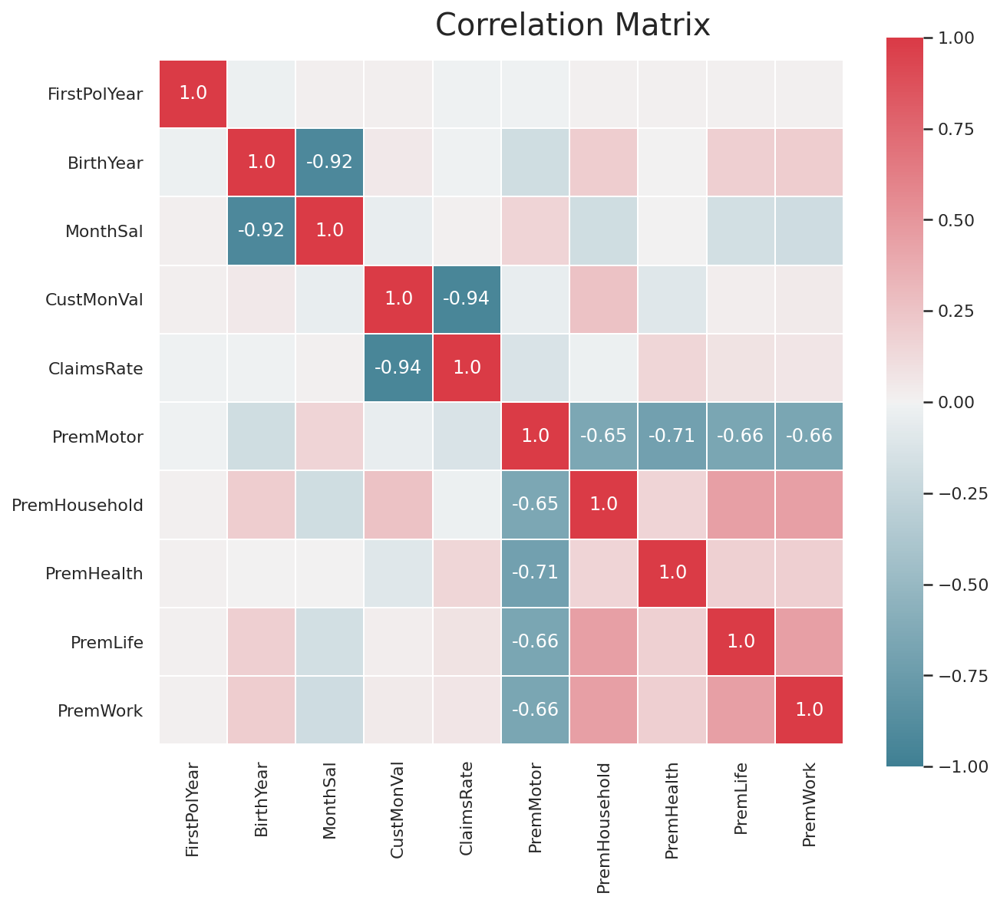

In [24]:
# Detect correlations
figure = plt.figure(figsize=(10, 8))
corr = np.round(data[metric_features].corr(method="pearson"), decimals=2)
mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape, ""))
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)
figure.subplots_adjust(top=0.95)
figure.suptitle("Correlation Matrix", fontsize=20)
plt.show()

In [25]:
# Rework date features
data["Age"] = 2016 - data["BirthYear"]
data["CustYears"] = 2016 - data["FirstPolYear"]
metric_features.append("Age")
metric_features.append("CustYears")
data.drop(columns=["BirthYear", "FirstPolYear"], inplace=True)
metric_features.remove("BirthYear")
metric_features.remove("FirstPolYear")

In [26]:
# Remove correlated features
data.drop(columns=["MonthSal", "ClaimsRate"], inplace=True)
metric_features.remove("MonthSal")
metric_features.remove("ClaimsRate")

In [27]:
# Remove irrelevant features
data.drop(columns=["GeoLivArea"], inplace=True)
non_metric_features.remove("GeoLivArea")

## Normalization

In [28]:
data_minmax = data.copy()

In [29]:
scaler = MinMaxScaler()
data_minmax[metric_features] = scaler.fit_transform(data_minmax[metric_features])
data_minmax.head()

,EducDeg,Children,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,Age,CustYears
CustID,,,,,,,,,,
1,b'2 - High School',1,0.483697,0.641146,0.118180,0.333663,0.283547,0.139842,0.287879,0.541667
3,b'1 - Basic',0,0.569937,0.350285,0.229168,0.284716,0.490078,0.537393,0.469697,0.291667
4,b'3 - BSc/MSc',1,0.206251,0.309715,0.090558,0.704047,0.222281,0.195266,0.303030,0.333333
5,b'3 - BSc/MSc',1,0.242657,0.577334,0.093963,0.415084,0.135342,0.258725,0.424242,0.500000
6,b'2 - High School',1,0.201134,0.752382,0.071849,0.262737,0.073499,0.095213,0.681818,0.500000


In [30]:
data = data_minmax.copy()

## One-hot encoding

In [31]:
data_ohc = data.copy()

In [32]:
encoder = OneHotEncoder(sparse=False, drop="if_binary", dtype="int64")
ohc_features = encoder.fit_transform(data_ohc[non_metric_features])
ohc_feature_names = encoder.get_feature_names(non_metric_features)
ohc_data = pd.DataFrame(ohc_features, index=data_ohc.index, columns=ohc_feature_names)
data_ohc = pd.concat([data_ohc.drop(columns=non_metric_features), ohc_data], axis=1)
data_ohc.head()

,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,Age,CustYears,EducDeg_b'1 - Basic',EducDeg_b'2 - High School',EducDeg_b'3 - BSc/MSc',EducDeg_b'4 - PhD',Children_1
CustID,,,,,,,,,,,,,
1,0.483697,0.641146,0.118180,0.333663,0.283547,0.139842,0.287879,0.541667,0,1,0,0,1
3,0.569937,0.350285,0.229168,0.284716,0.490078,0.537393,0.469697,0.291667,1,0,0,0,0
4,0.206251,0.309715,0.090558,0.704047,0.222281,0.195266,0.303030,0.333333,0,0,1,0,1
5,0.242657,0.577334,0.093963,0.415084,0.135342,0.258725,0.424242,0.500000,0,0,1,0,1
6,0.201134,0.752382,0.071849,0.262737,0.073499,0.095213,0.681818,0.500000,0,1,0,0,1


In [33]:
data = data_ohc.copy()

# Clustering

## Exploration

### t-SNE

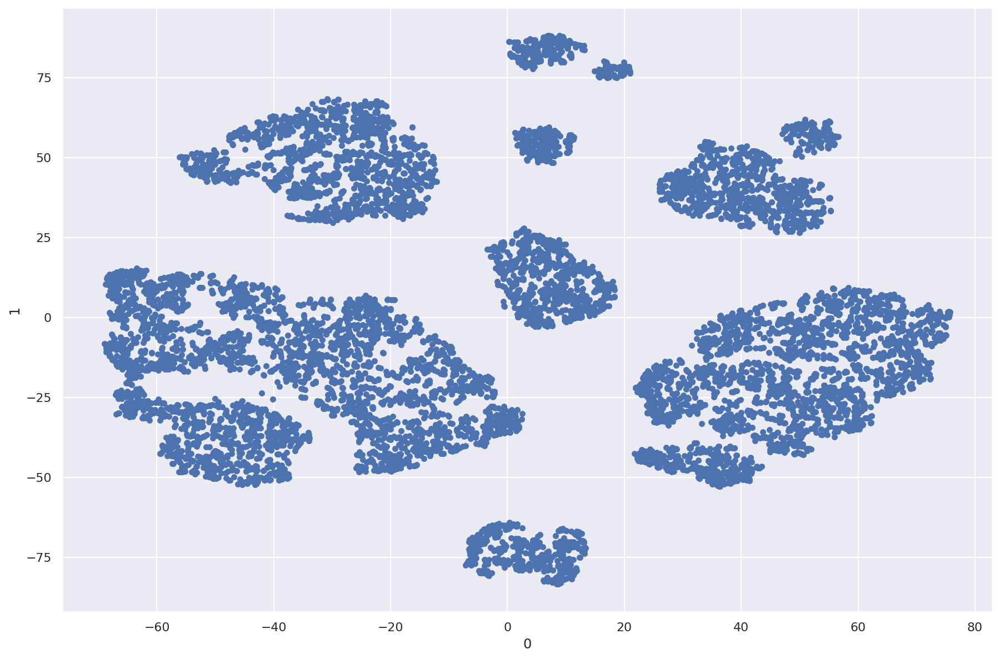

In [34]:
two_dim_tsne = TSNE(perplexity=40.0, init="pca", random_state=42).fit_transform(data)
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, colormap="tab10", figsize=(15, 10))
plt.show()

### UMAP

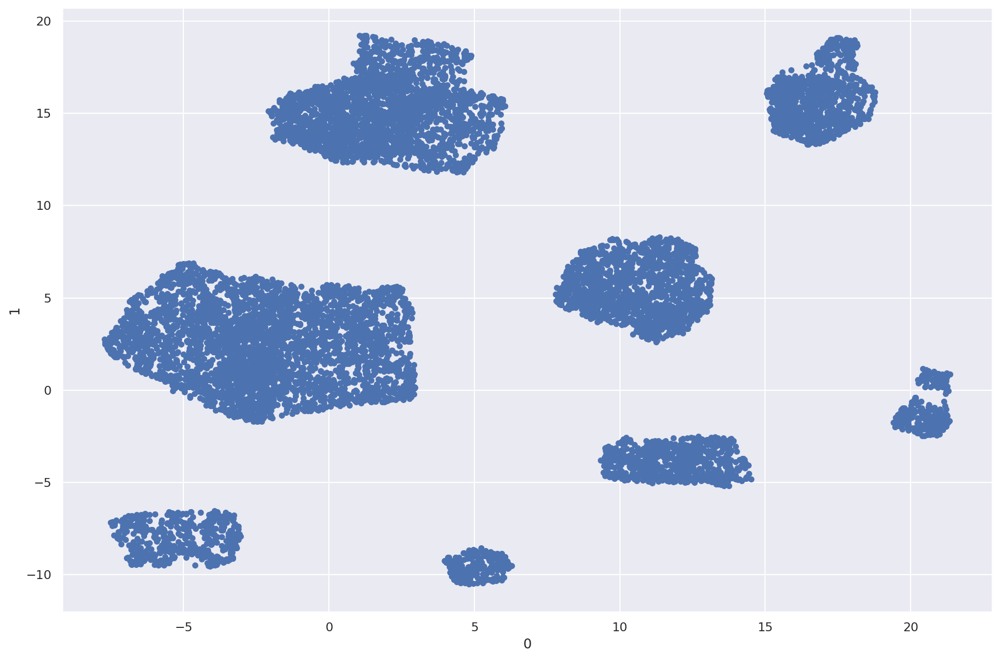

In [35]:
    two_dim_umap = UMAP(n_neighbors=15, min_dist=0.5, init="spectral", random_state=42).fit_transform(data)
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, colormap="tab10", figsize=(15, 10))
plt.show()

## K-Means clustering

In [36]:
kmeans = KMeans(n_clusters=8, init="k-means++", n_init=50, random_state=42)
labels_kmeans = kmeans.fit_predict(data)
score = silhouette_score(data, labels_kmeans)
print("Silhouette score:", score)

Silhouette score: 0.35574321099824524


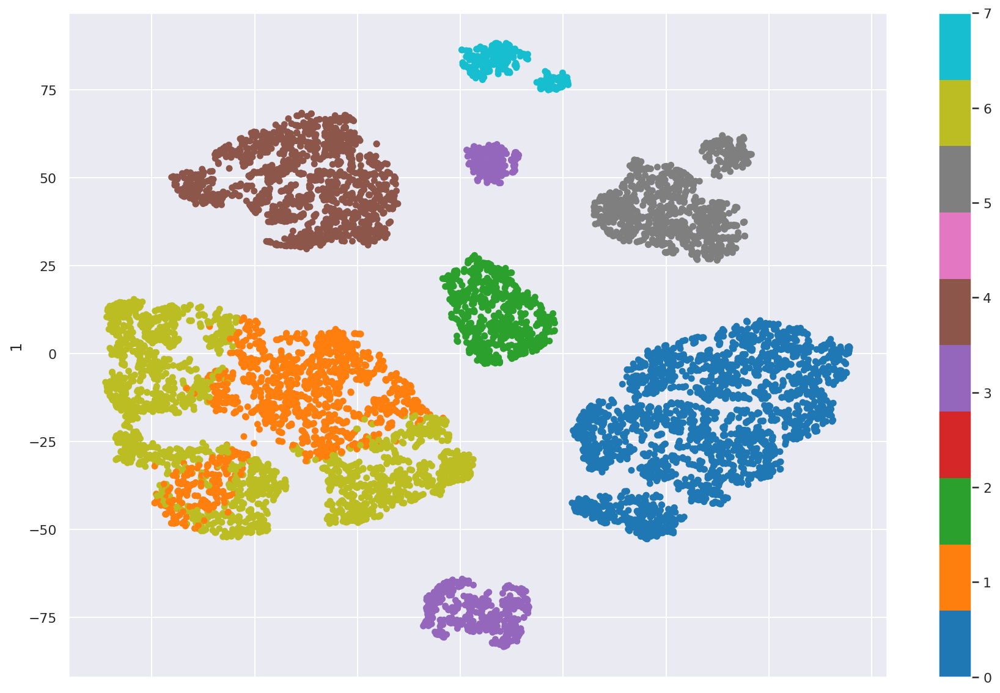

In [37]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_kmeans, colormap="tab10", figsize=(15, 10))
plt.show()

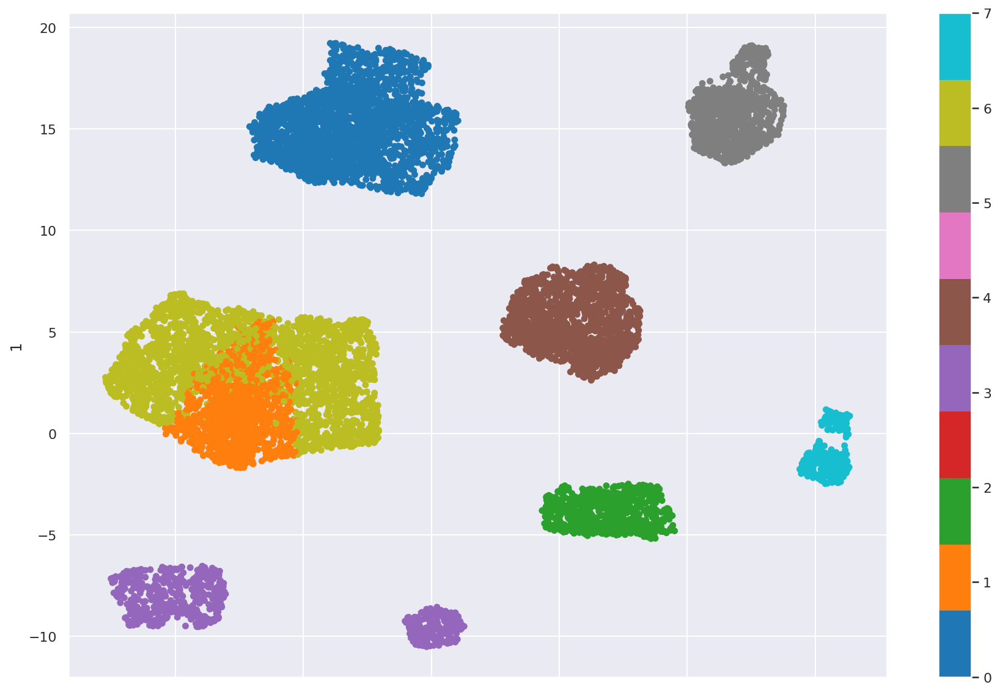

In [38]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_kmeans, colormap="tab10", figsize=(15, 10))
plt.show()

## Hierarchical clustering

### Single linkage

In [39]:
aggl_single = AgglomerativeClustering(linkage="single", affinity="euclidean", n_clusters=8)
labels_aggl_single = aggl_single.fit_predict(data)
score = silhouette_score(data, labels_aggl_single)
print("Silhouette score:", score)

Silhouette score: 0.44570628227494885


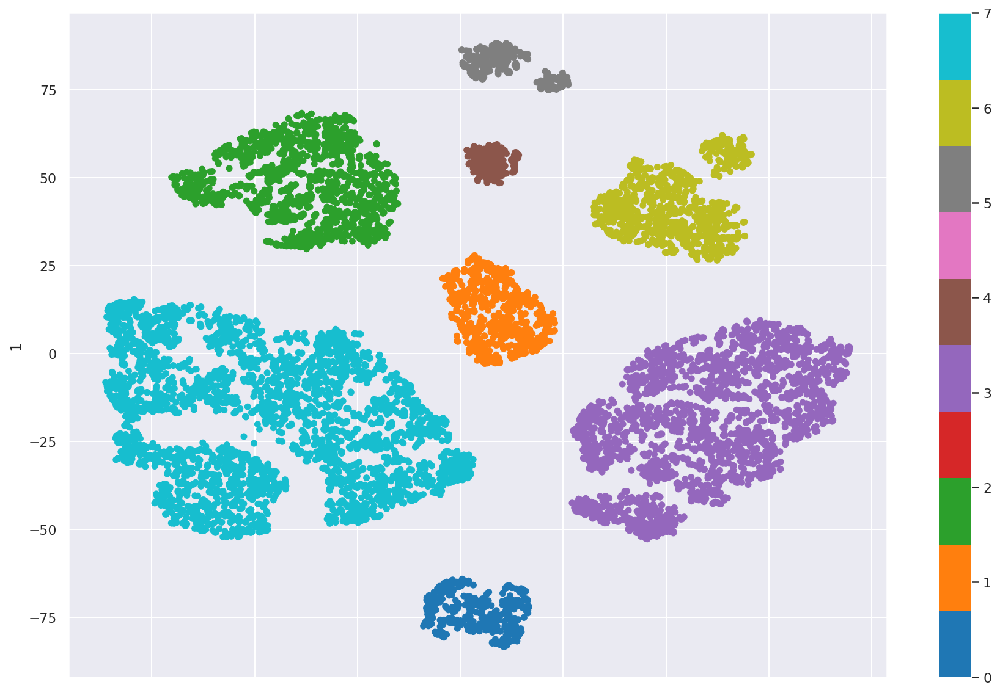

In [40]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_aggl_single, colormap="tab10", figsize=(15, 10))
plt.show()

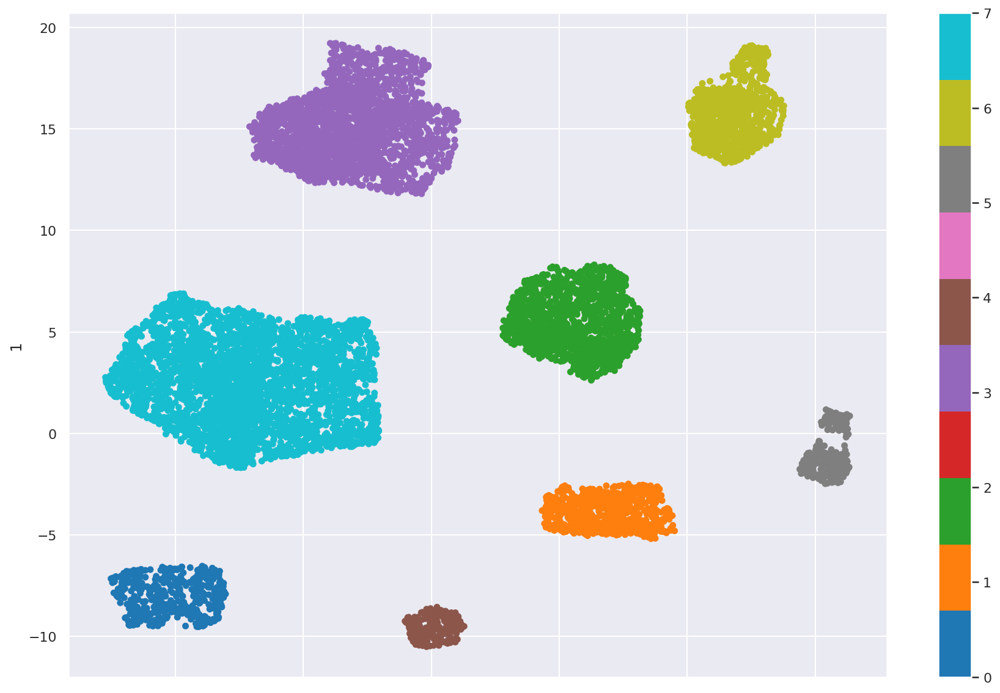

In [41]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_aggl_single, colormap="tab10", figsize=(15, 10))
plt.show()

### Average linkage

In [42]:
aggl_average = AgglomerativeClustering(linkage="average", affinity="euclidean", n_clusters=8)
labels_aggl_average = aggl_average.fit_predict(data)
score = silhouette_score(data, labels_aggl_average)
print("Silhouette score:", score)

Silhouette score: 0.4298958696228286


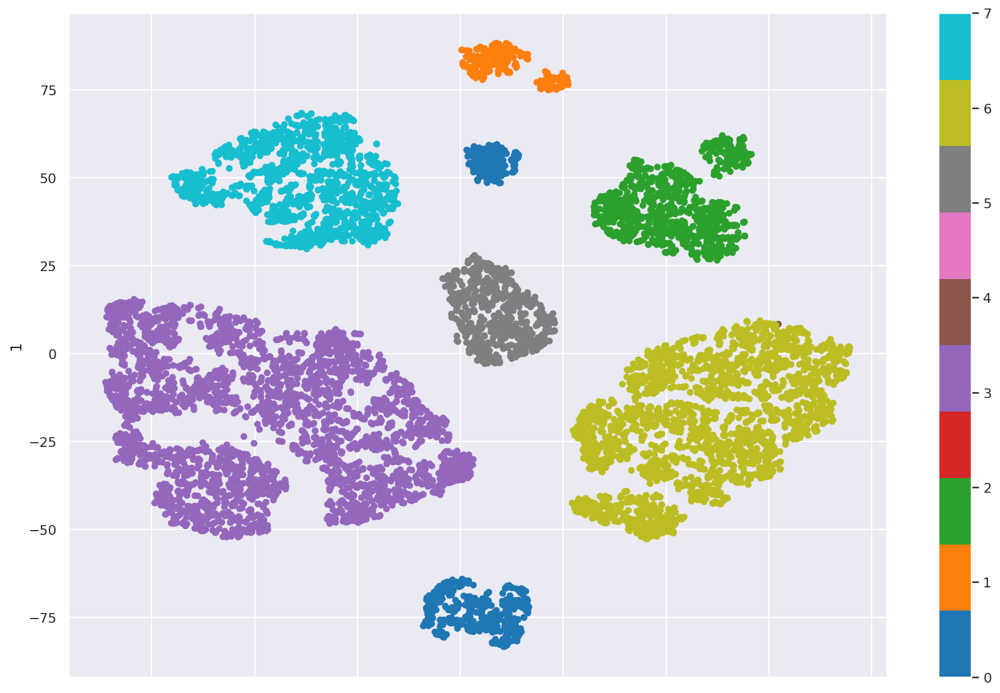

In [43]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_aggl_average, colormap="tab10", figsize=(15, 10))
plt.show()

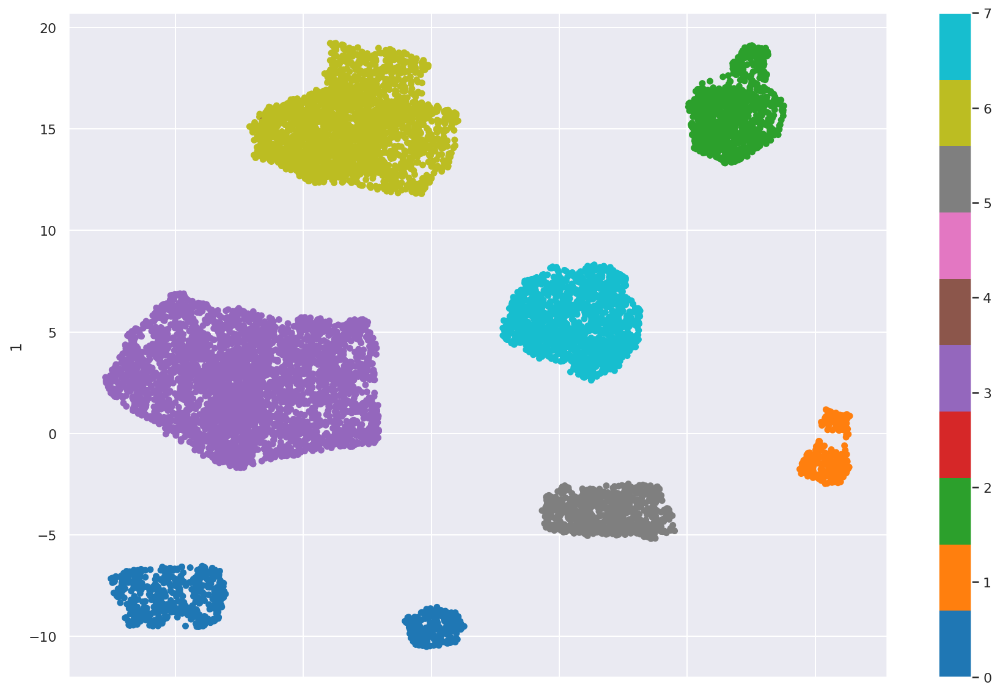

In [44]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_aggl_average, colormap="tab10", figsize=(15, 10))
plt.show()

### Complete linkage

In [45]:
aggl_complete = AgglomerativeClustering(linkage="complete", affinity="euclidean", n_clusters=8)
labels_aggl_complete = aggl_complete.fit_predict(data)
score = silhouette_score(data, labels_aggl_complete)
print("Silhouette score:", score)

Silhouette score: 0.41748090237671676


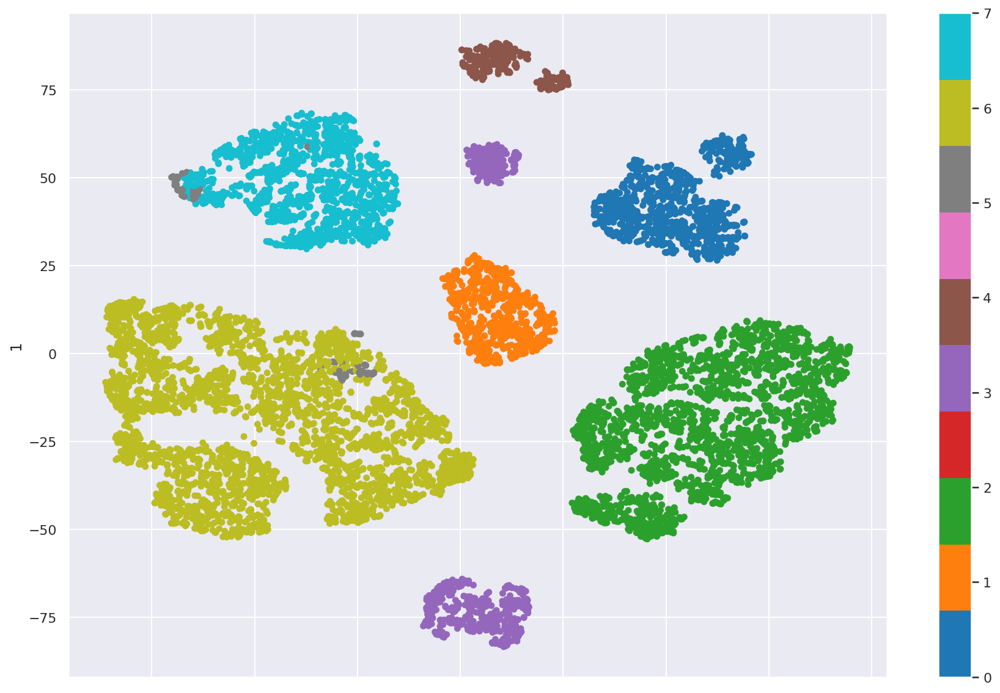

In [46]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_aggl_complete, colormap="tab10", figsize=(15, 10))
plt.show()

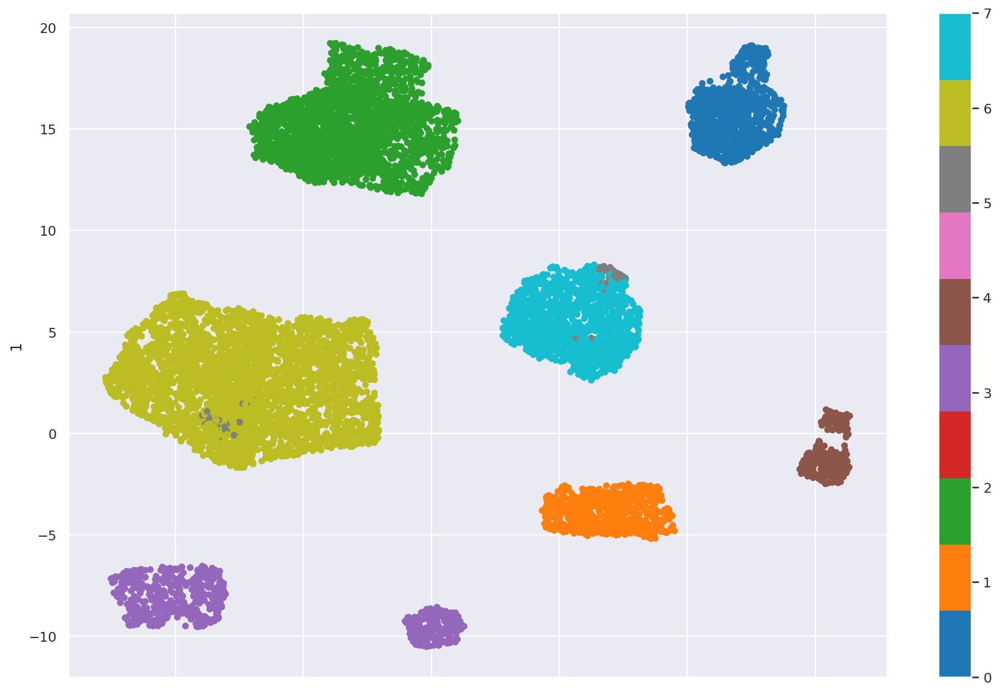

In [47]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_aggl_complete, colormap="tab10", figsize=(15, 10))
plt.show()

### Ward linkage

In [48]:
aggl_ward = AgglomerativeClustering(linkage="ward", affinity="euclidean", n_clusters=8)
labels_aggl_ward = aggl_ward.fit_predict(data)
score = silhouette_score(data, labels_aggl_ward)
print("Silhouette score:", score)

Silhouette score: 0.44570628227494885


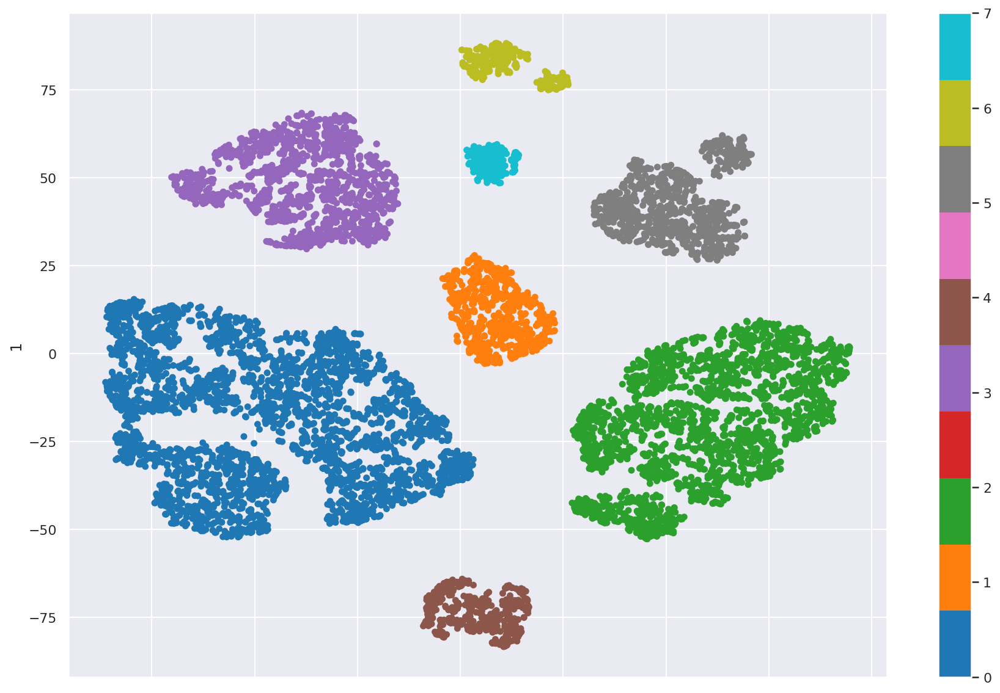

In [49]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_aggl_ward, colormap="tab10", figsize=(15, 10))
plt.show()

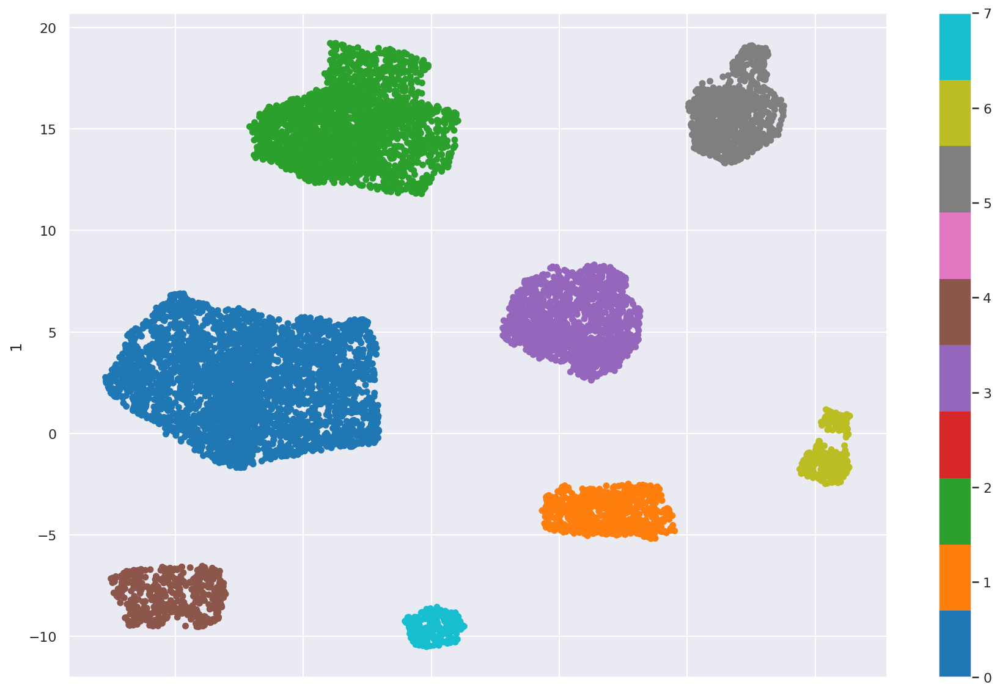

In [50]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_aggl_ward, colormap="tab10", figsize=(15, 10))
plt.show()

## DBSCAN

### Eps = 0.25

In [51]:
dbscan_0p25 = DBSCAN(eps=0.25)
labels_dbscan_0p25 = dbscan_0p25.fit_predict(data)
score = silhouette_score(data, labels_dbscan_0p25)
print("Silhouette score:", score)

Silhouette score: 0.1641620207975157


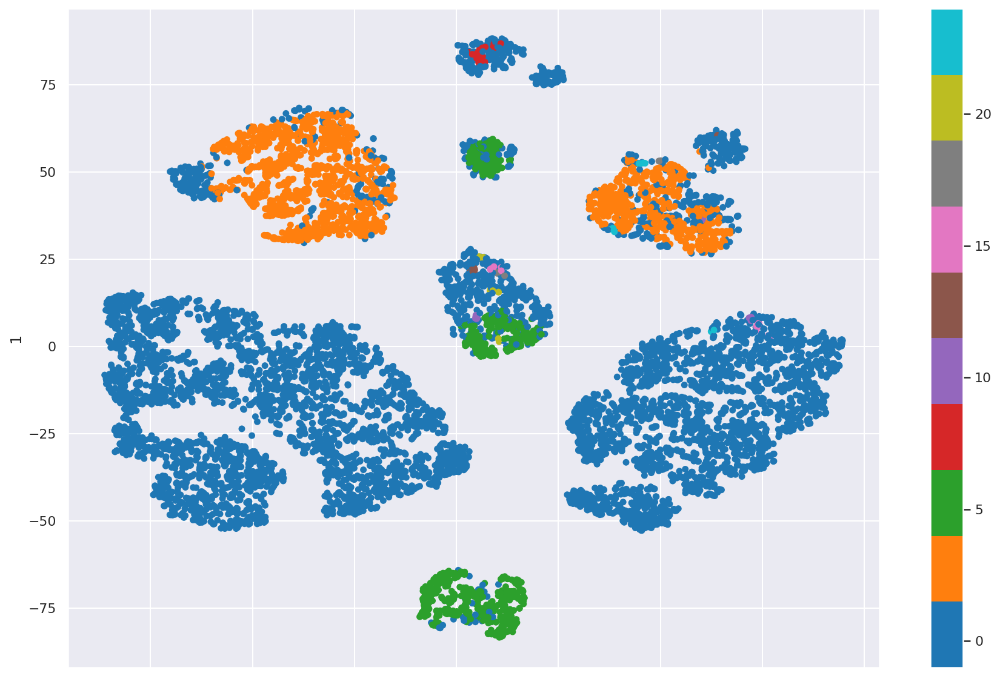

In [52]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_dbscan_0p25, colormap="tab10", figsize=(15, 10))
plt.show()

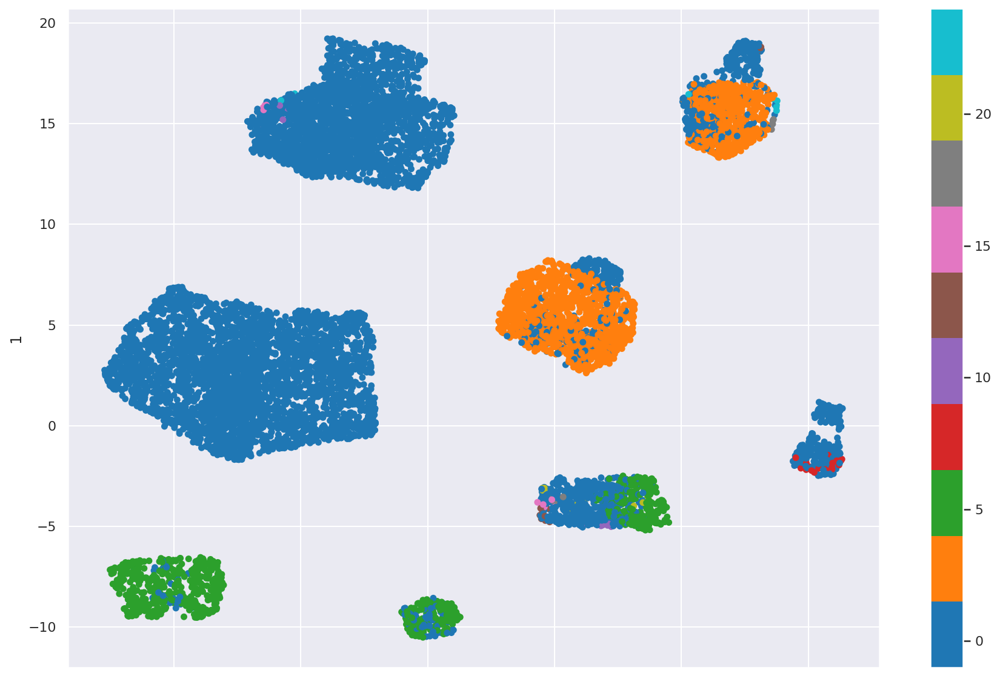

In [53]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_dbscan_0p25, colormap="tab10", figsize=(15, 10))
plt.show()

### Eps = 0.5

In [54]:
dbscan_0p5 = DBSCAN(eps=0.5)
labels_dbscan_0p5 = dbscan_0p5.fit_predict(data)
score = silhouette_score(data, labels_dbscan_0p5)
print("Silhouette score:", score)

Silhouette score: 0.4448774855781917


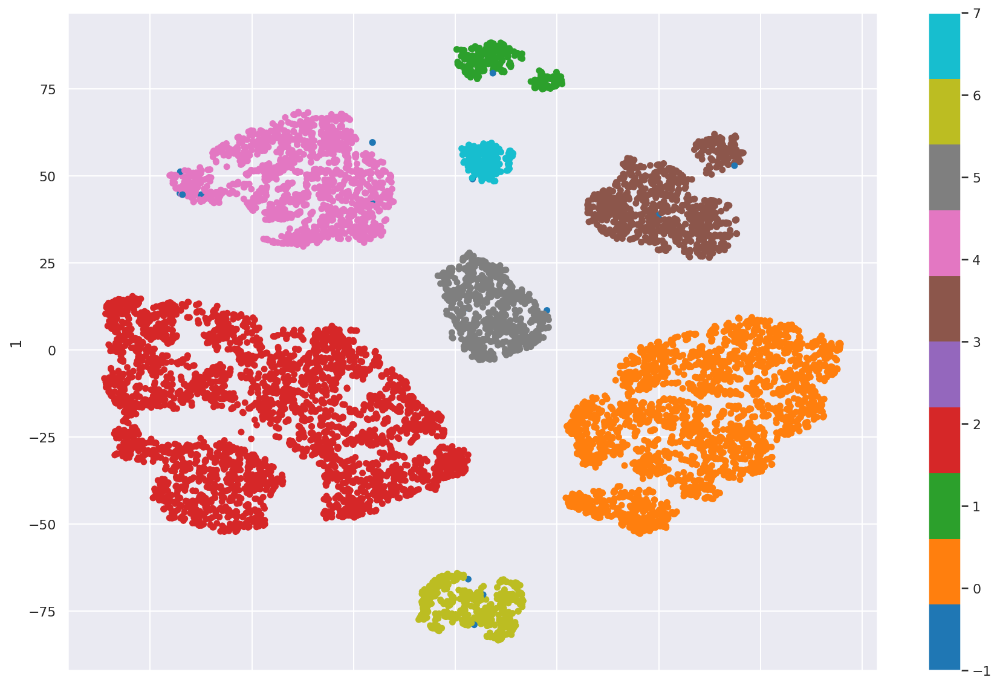

In [55]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_dbscan_0p5, colormap="tab10", figsize=(15, 10))
plt.show()

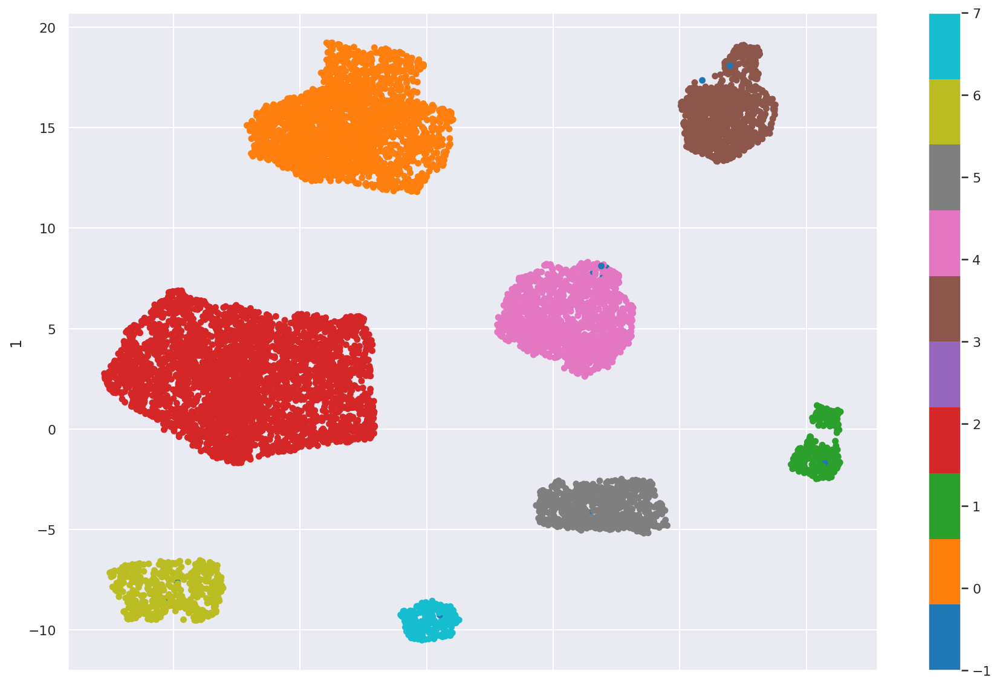

In [56]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_dbscan_0p5, colormap="tab10", figsize=(15, 10))
plt.show()

### Eps = 0.75

In [57]:
dbscan_0p75 = DBSCAN(eps=0.75)
labels_dbscan_0p75 = dbscan_0p75.fit_predict(data)
score = silhouette_score(data, labels_dbscan_0p75)
print("Silhouette score:", score)

Silhouette score: 0.44570628227494885


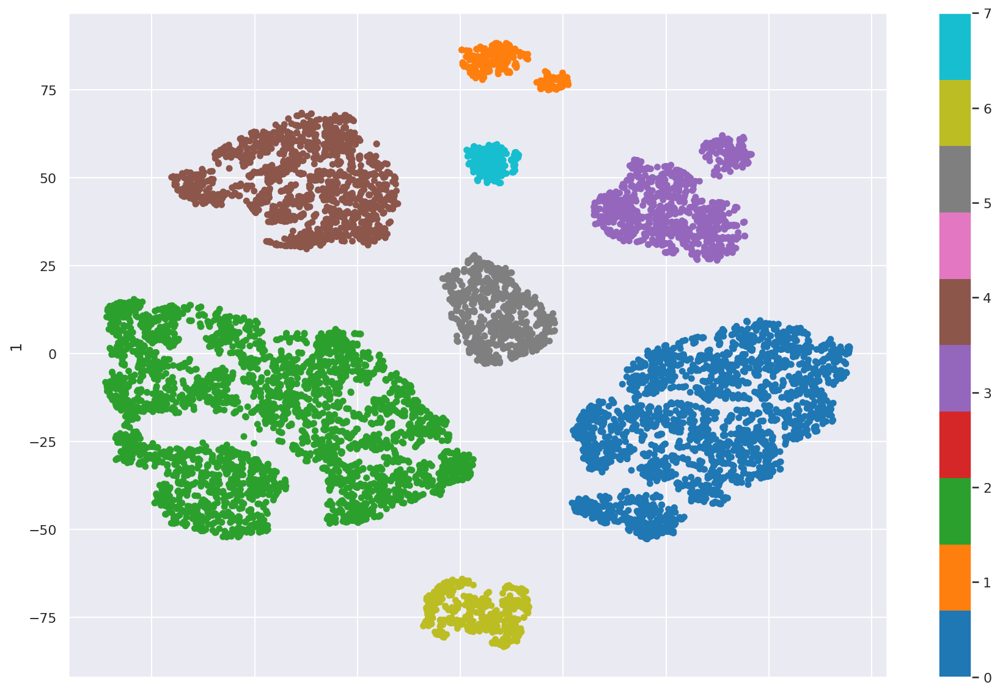

In [58]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_dbscan_0p75, colormap="tab10", figsize=(15, 10))
plt.show()

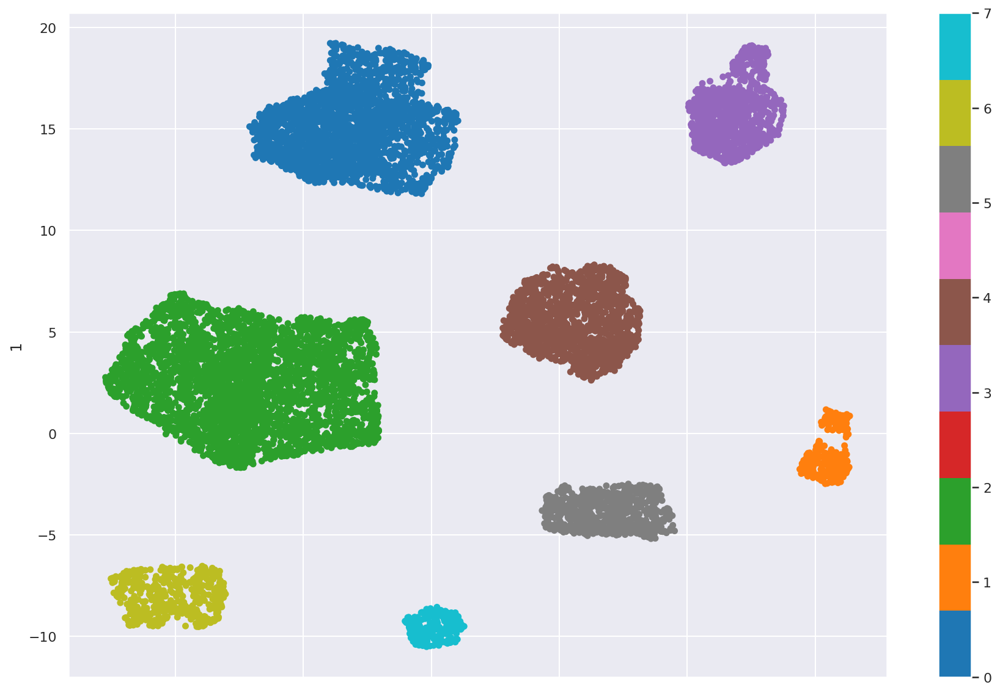

In [59]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_dbscan_0p75, colormap="tab10", figsize=(15, 10))
plt.show()

### Eps = 1.0

In [60]:
dbscan_1p0 = DBSCAN(eps=1.0)
labels_dbscan_1p0 = dbscan_1p0.fit_predict(data)
score = silhouette_score(data, labels_dbscan_1p0)
print("Silhouette score:", score)

Silhouette score: 0.4302930426250475


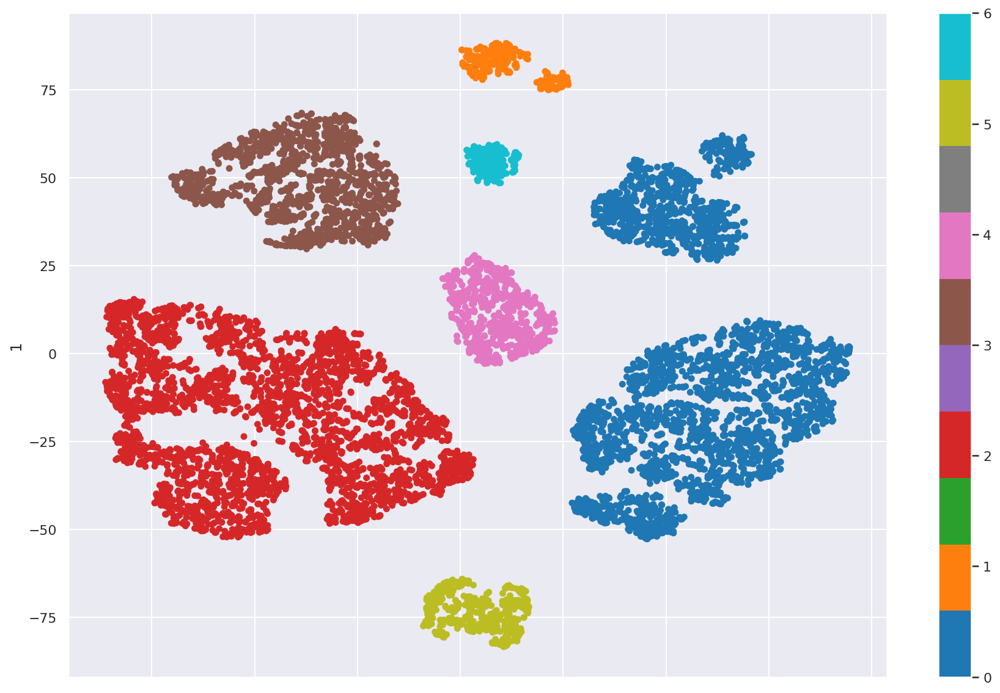

In [61]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_dbscan_1p0, colormap="tab10", figsize=(15, 10))
plt.show()

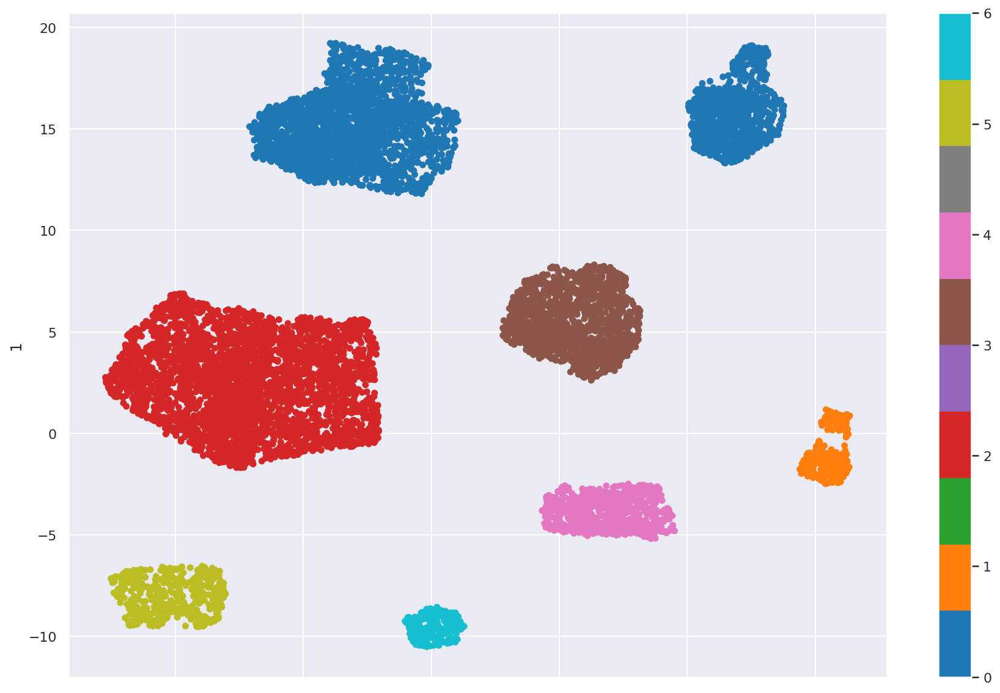

In [62]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_dbscan_1p0, colormap="tab10", figsize=(15, 10))
plt.show()

## Self-organizing maps

### Training

In [63]:
np.random.seed(42)
som = sompy.SOMFactory().build(
    data.values, 
    mapsize=[50, 50],
    initialization="random",
    neighborhood="gaussian",
    training="batch",
    lattice="hexa",
    component_names=data.columns
)
som.train(n_job=-1, verbose="info", train_rough_len=100, train_finetune_len=100)

 Training...
 random_initialization took: 0.001000 seconds
 Rough training...
 radius_ini: 17.000000 , radius_final: 2.833333, trainlen: 100

 epoch: 1 ---> elapsed time:  1.428000, quantization error: 2.841094

 epoch: 2 ---> elapsed time:  0.717000, quantization error: 3.460663

 epoch: 3 ---> elapsed time:  1.259000, quantization error: 3.439567

 epoch: 4 ---> elapsed time:  1.108000, quantization error: 3.428516

 epoch: 5 ---> elapsed time:  1.083000, quantization error: 3.416056

 epoch: 6 ---> elapsed time:  0.735000, quantization error: 3.404568

 epoch: 7 ---> elapsed time:  1.414000, quantization error: 3.400463

 epoch: 8 ---> elapsed time:  1.157000, quantization error: 3.398903

 epoch: 9 ---> elapsed time:  0.854000, quantization error: 3.397740

 epoch: 10 ---> elapsed time:  1.246000, quantization error: 3.396576

 epoch: 11 ---> elapsed time:  1.194000, quantization error: 3.395381

 epoch: 12 ---> elapsed time:  1.241000, quantization error: 3.394152

 epoch: 13 --->

 epoch: 14 ---> elapsed time:  1.190000, quantization error: 2.640406

 epoch: 15 ---> elapsed time:  1.220000, quantization error: 2.631662

 epoch: 16 ---> elapsed time:  1.119000, quantization error: 2.622760

 epoch: 17 ---> elapsed time:  0.917000, quantization error: 2.613703

 epoch: 18 ---> elapsed time:  0.908000, quantization error: 2.604766

 epoch: 19 ---> elapsed time:  0.832000, quantization error: 2.595792

 epoch: 20 ---> elapsed time:  0.985000, quantization error: 2.586714

 epoch: 21 ---> elapsed time:  1.062000, quantization error: 2.577630

 epoch: 22 ---> elapsed time:  1.111000, quantization error: 2.568480

 epoch: 23 ---> elapsed time:  1.124000, quantization error: 2.559264

 epoch: 24 ---> elapsed time:  1.210000, quantization error: 2.549965

 epoch: 25 ---> elapsed time:  1.342000, quantization error: 2.540531

 epoch: 26 ---> elapsed time:  1.277000, quantization error: 2.531042

 epoch: 27 ---> elapsed time:  1.095000, quantization error: 2.521385

 epoch

### Component planes

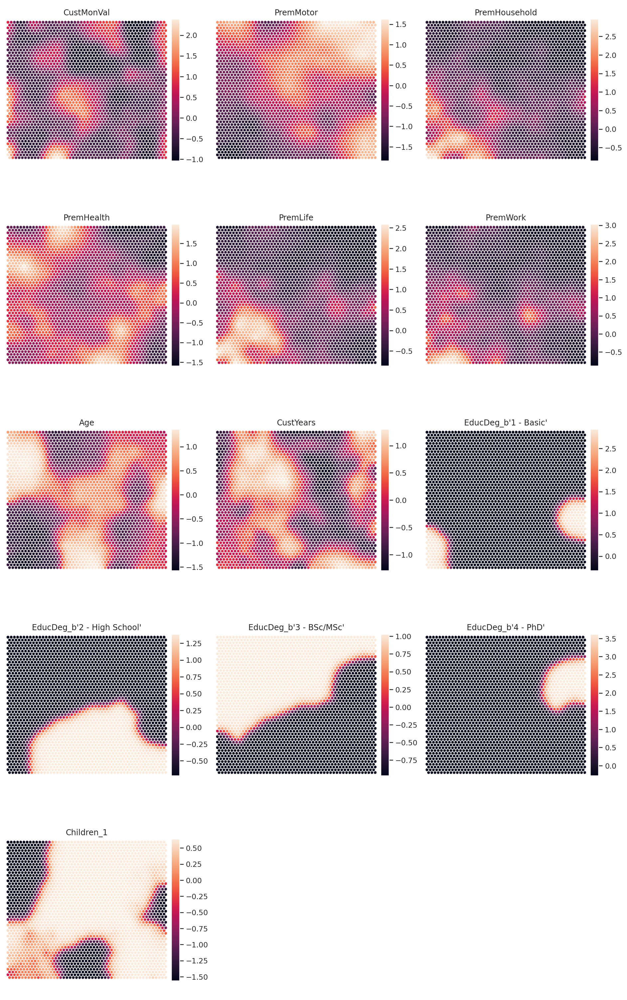

In [64]:
view2D = View2D(12, 12, "", text_size=10)
view2D.show(som, col_sz=3, what="codebook")
plt.subplots_adjust(top=0.90)
plt.show()

### U-Matrix

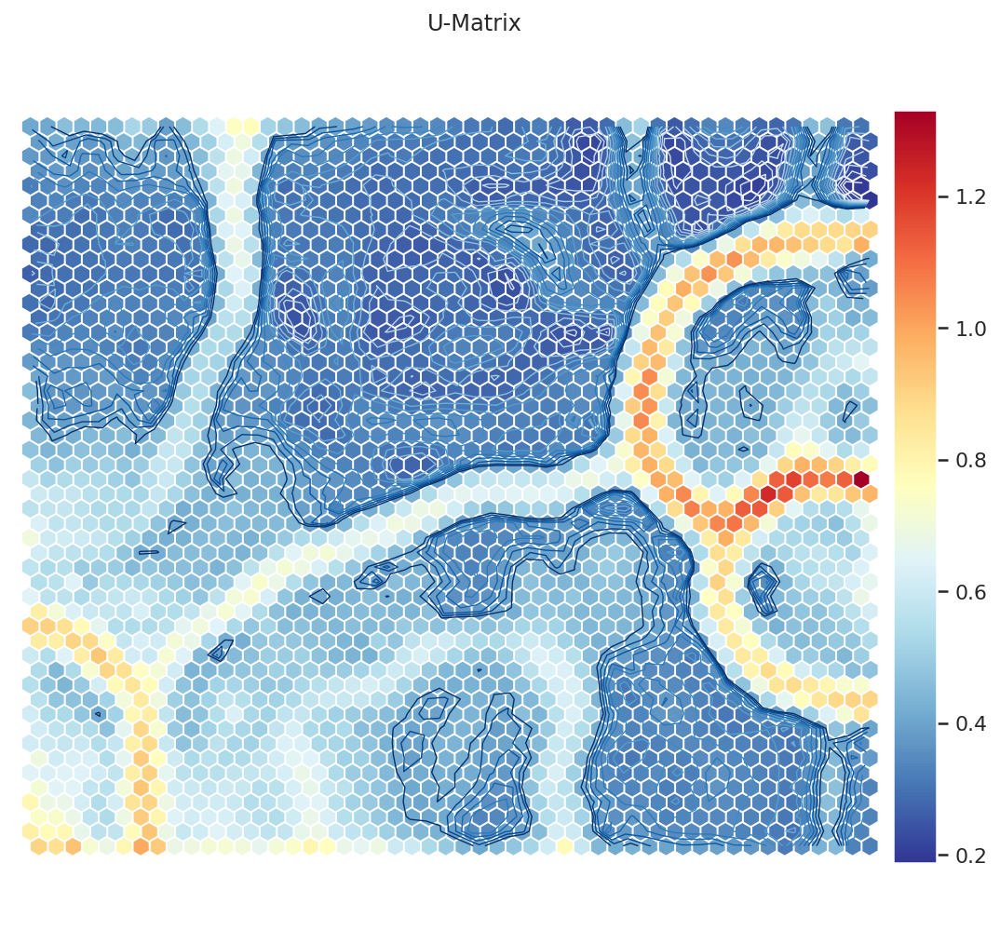

In [65]:
umat = sompy.umatrix.UMatrixView(9, 9, "U-Matrix", show_axis=True, text_size=8, show_text=True)
show = umat.show(som, distance=2, row_normalized=False, show_data=False, contour=True)

### K-Means over SOM

In [66]:
kmeans = KMeans(n_clusters=8, init="k-means++", n_init=50, random_state=42)
node_labels = kmeans.fit_predict(som.codebook.matrix)
som.cluster_labels = node_labels
bmus = som.find_bmu(data)[0].astype("int64")
labels_som_kmeans = node_labels[bmus]
score = silhouette_score(data, labels_som_kmeans)
print("Silhouette score:", score)

Silhouette score: 0.027899178557059572


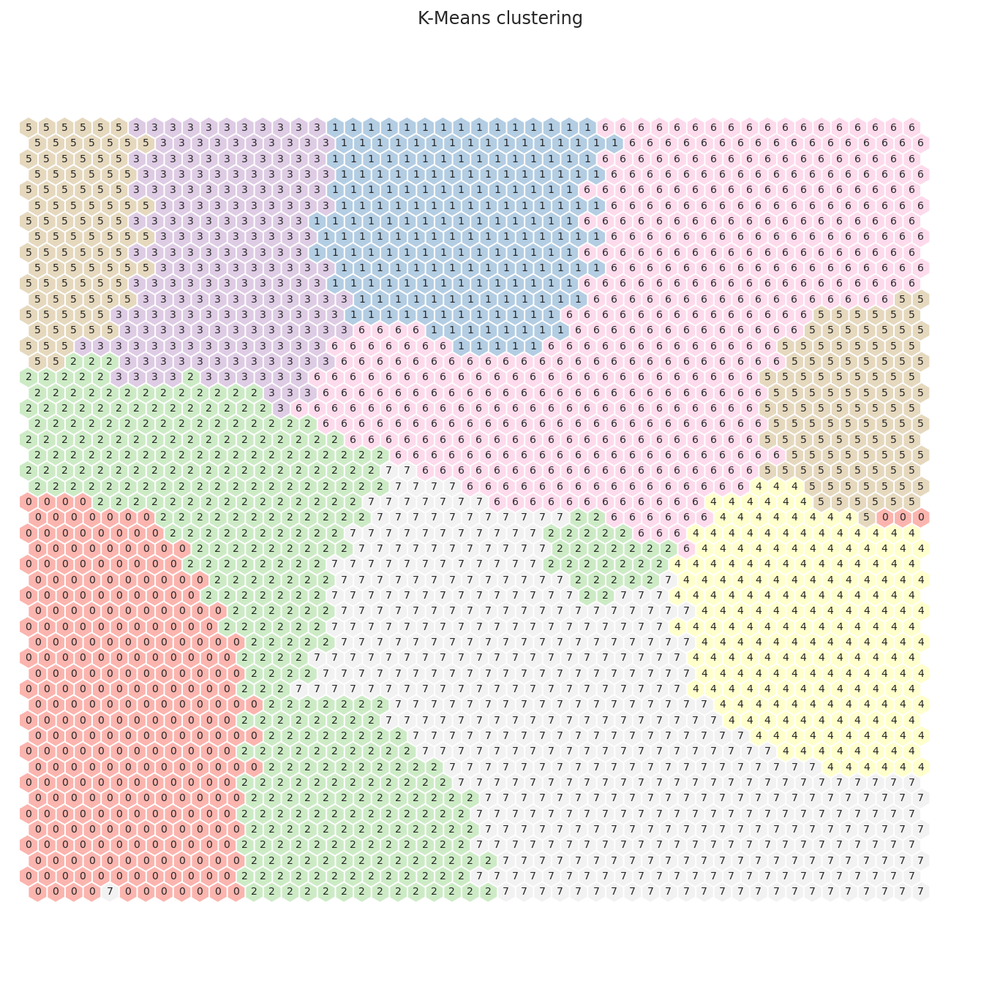

In [67]:
hits  = HitMapView(12, 12, "K-Means clustering", text_size=10)
hits.show(som, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")
plt.show()

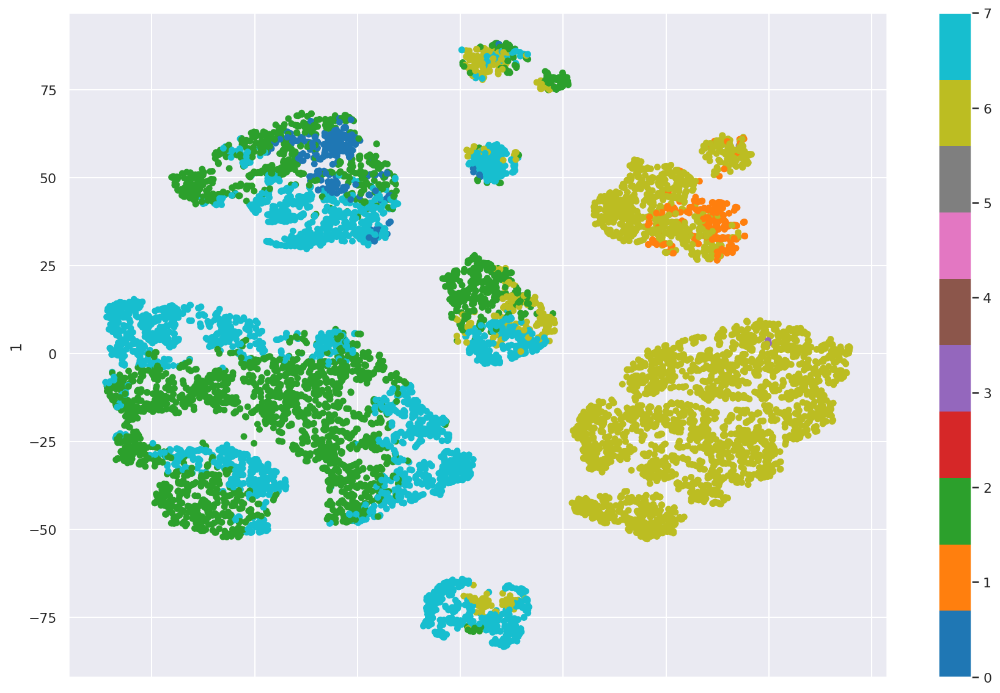

In [68]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_som_kmeans, colormap="tab10", figsize=(15, 10))
plt.show()

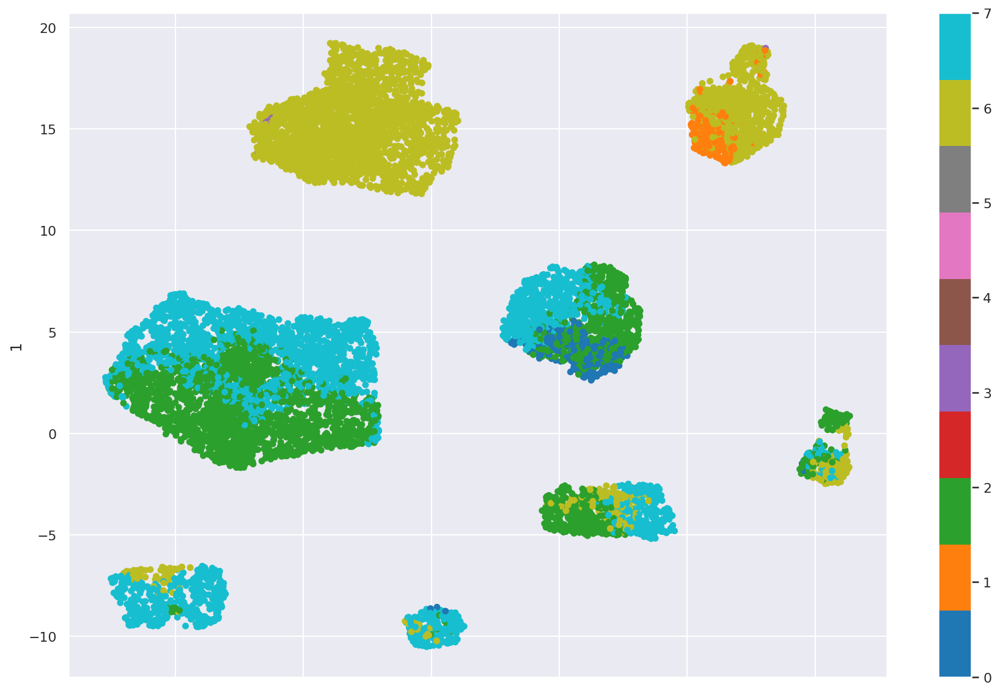

In [69]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_som_kmeans, colormap="tab10", figsize=(15, 10))
plt.show()

### Hierarchical clustering over SOM (single linkage)

In [70]:
aggl_single = AgglomerativeClustering(linkage="single", affinity="euclidean", n_clusters=8)
node_labels = aggl_single.fit_predict(som.codebook.matrix)
som.cluster_labels = node_labels
bmus = som.find_bmu(data)[0].astype("int64")
labels_som_aggl_single = node_labels[bmus]
score = silhouette_score(data, labels_som_aggl_single)
print("Silhouette score:", score)

Silhouette score: 0.19345851157139557


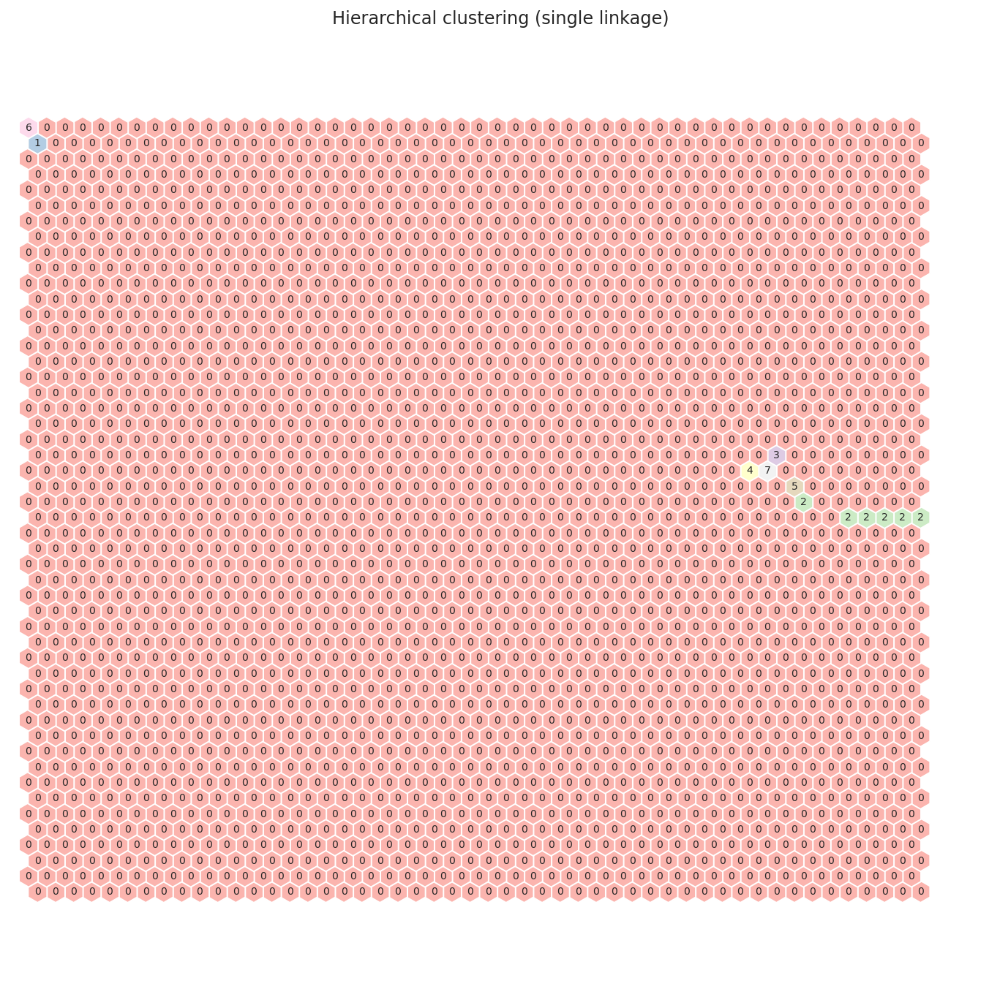

In [71]:
hits  = HitMapView(12, 12, "Hierarchical clustering (single linkage)", text_size=10)
hits.show(som, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")
plt.show()

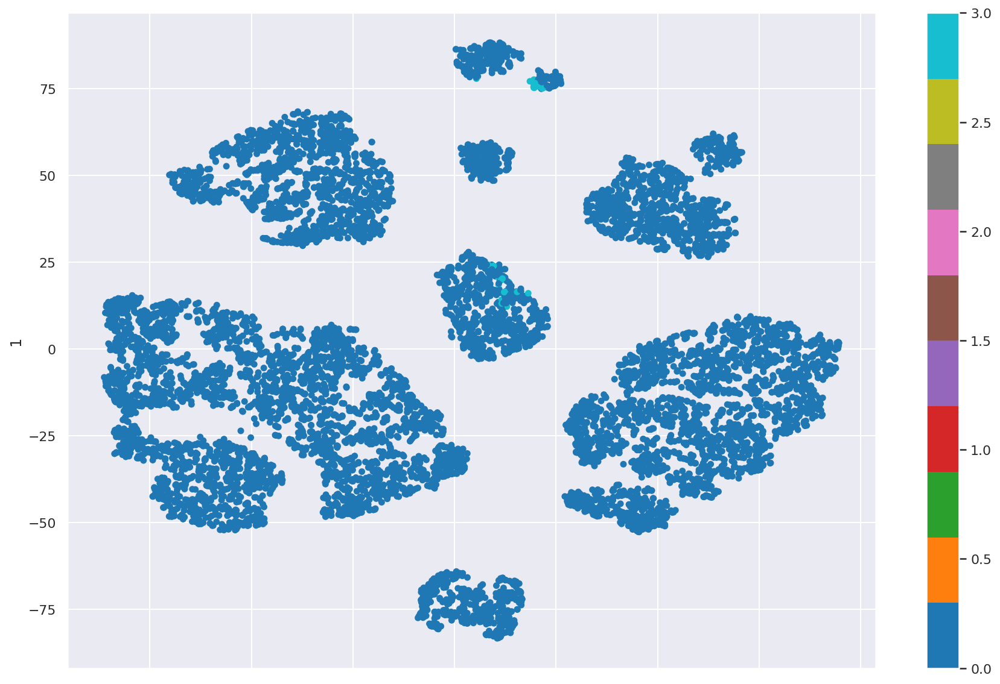

In [72]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_som_aggl_single, colormap="tab10", figsize=(15, 10))
plt.show()

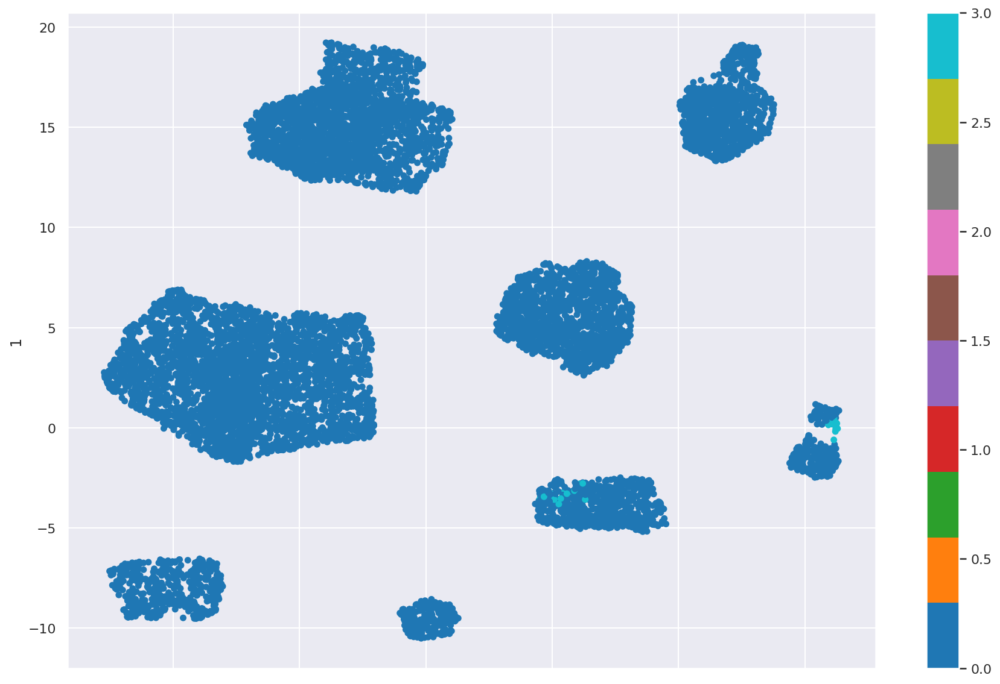

In [73]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_som_aggl_single, colormap="tab10", figsize=(15, 10))
plt.show()

### Hierarchical clustering over SOM (average linkage)

In [74]:
aggl_average = AgglomerativeClustering(linkage="average", affinity="euclidean", n_clusters=8)
node_labels = aggl_average.fit_predict(som.codebook.matrix)
som.cluster_labels = node_labels
bmus = som.find_bmu(data)[0].astype("int64")
labels_som_aggl_average = node_labels[bmus]
score = silhouette_score(data, labels_som_aggl_average)
print("Silhouette score:", score)

Silhouette score: 0.10327682239593361


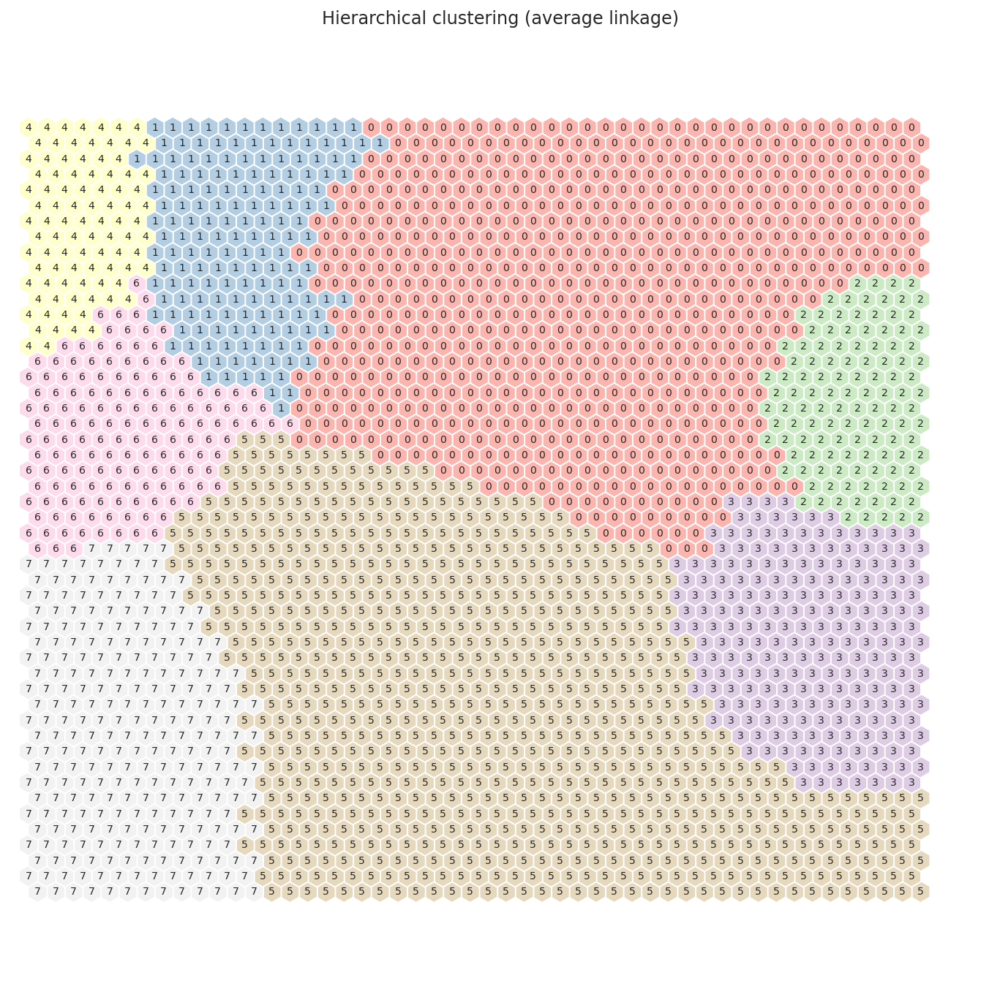

In [75]:
hits  = HitMapView(12, 12, "Hierarchical clustering (average linkage)", text_size=10)
hits.show(som, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")
plt.show()

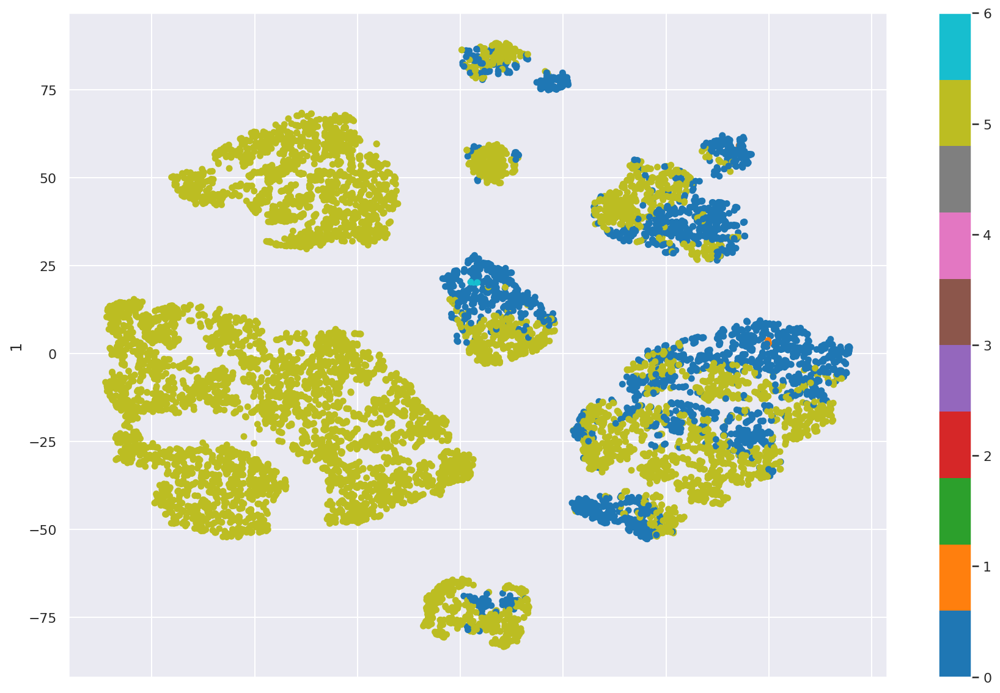

In [76]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_som_aggl_average, colormap="tab10", figsize=(15, 10))
plt.show()

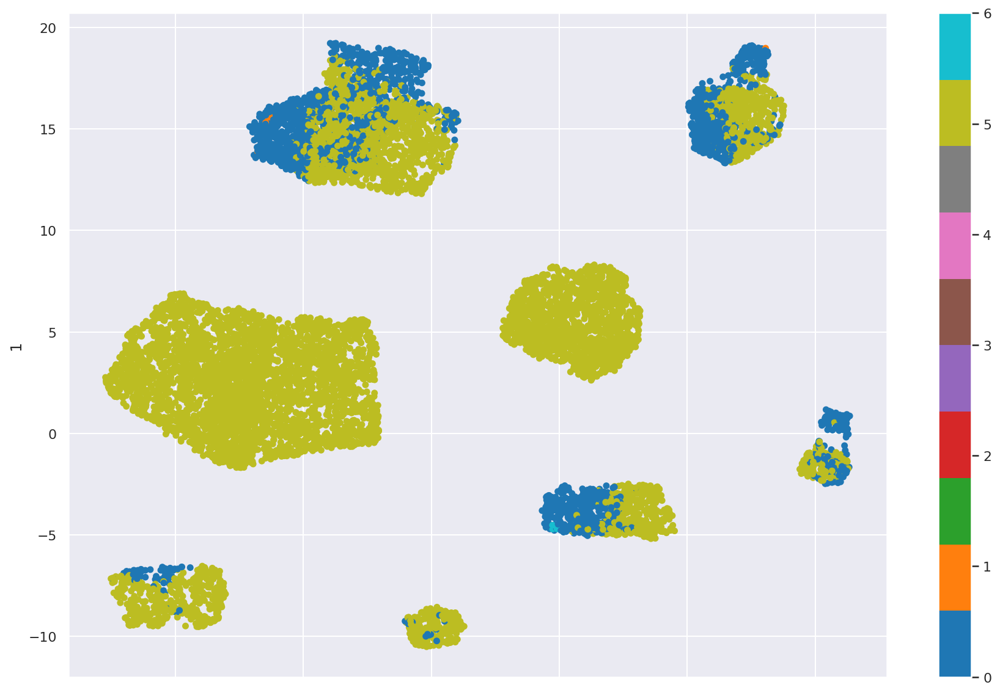

In [77]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_som_aggl_average, colormap="tab10", figsize=(15, 10))
plt.show()

### Hierarchical clustering over SOM (complete linkage)

In [78]:
aggl_complete = AgglomerativeClustering(linkage="complete", affinity="euclidean", n_clusters=8)
node_labels = aggl_complete.fit_predict(som.codebook.matrix)
som.cluster_labels = node_labels
bmus = som.find_bmu(data)[0].astype("int64")
labels_som_aggl_complete = node_labels[bmus]
score = silhouette_score(data, labels_som_aggl_complete)
print("Silhouette score:", score)

Silhouette score: 0.049210689735264615


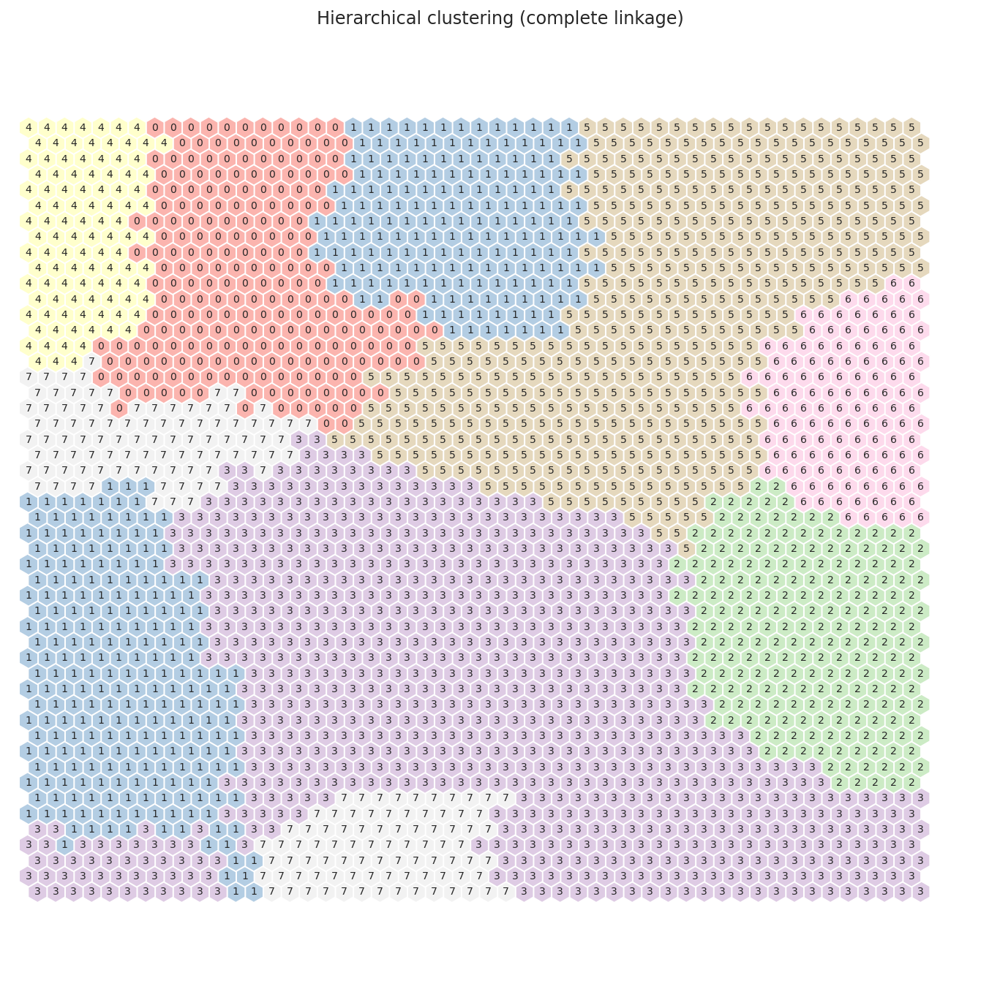

In [79]:
hits  = HitMapView(12, 12, "Hierarchical clustering (complete linkage)", text_size=10)
hits.show(som, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")
plt.show()

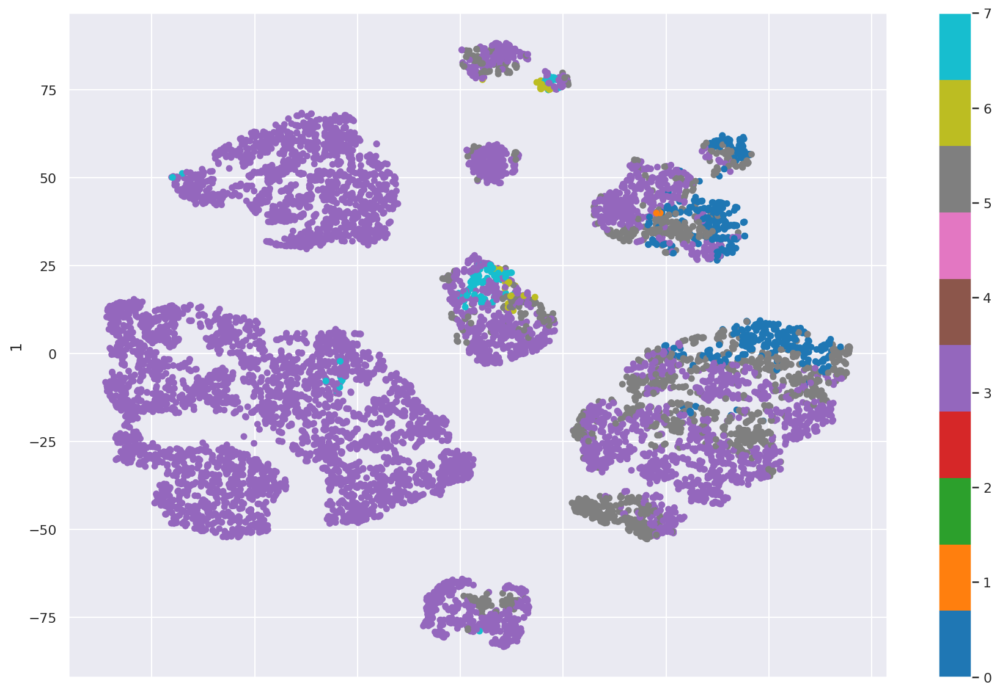

In [80]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_som_aggl_complete, colormap="tab10", figsize=(15, 10))
plt.show()

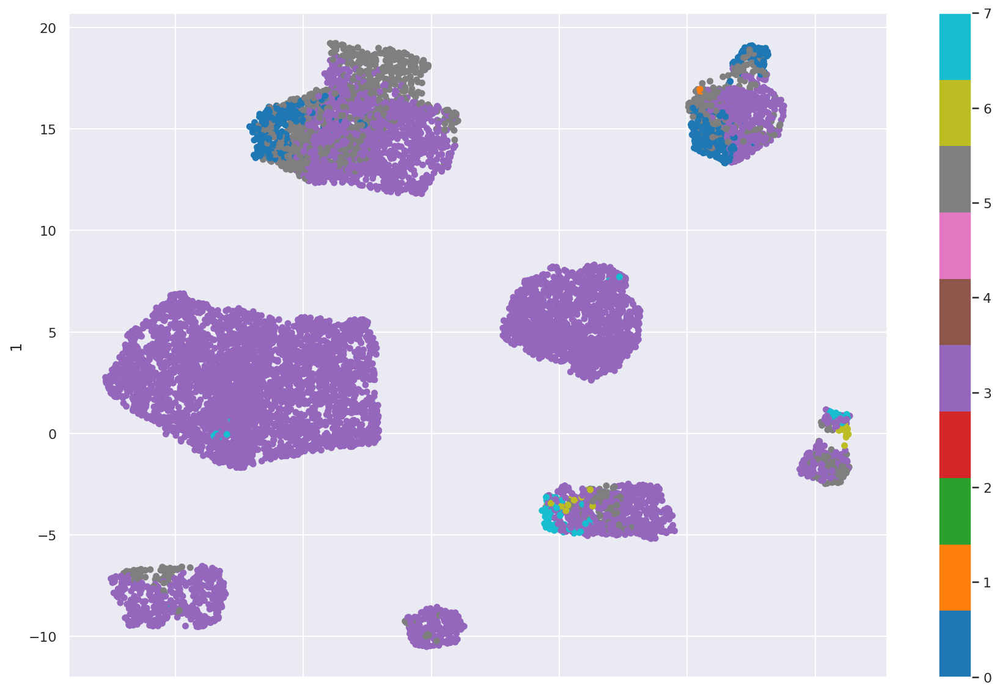

In [81]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_som_aggl_complete, colormap="tab10", figsize=(15, 10))
plt.show()

### Hierarchical clustering over SOM (Ward linkage)

In [82]:
aggl_ward = AgglomerativeClustering(linkage="ward", affinity="euclidean", n_clusters=8)
node_labels = aggl_ward.fit_predict(som.codebook.matrix)
som.cluster_labels = node_labels
bmus = som.find_bmu(data)[0].astype("int64")
labels_som_aggl_ward = node_labels[bmus]
score = silhouette_score(data, labels_som_aggl_ward)
print("Silhouette score:", score)

Silhouette score: -0.15950628915855938


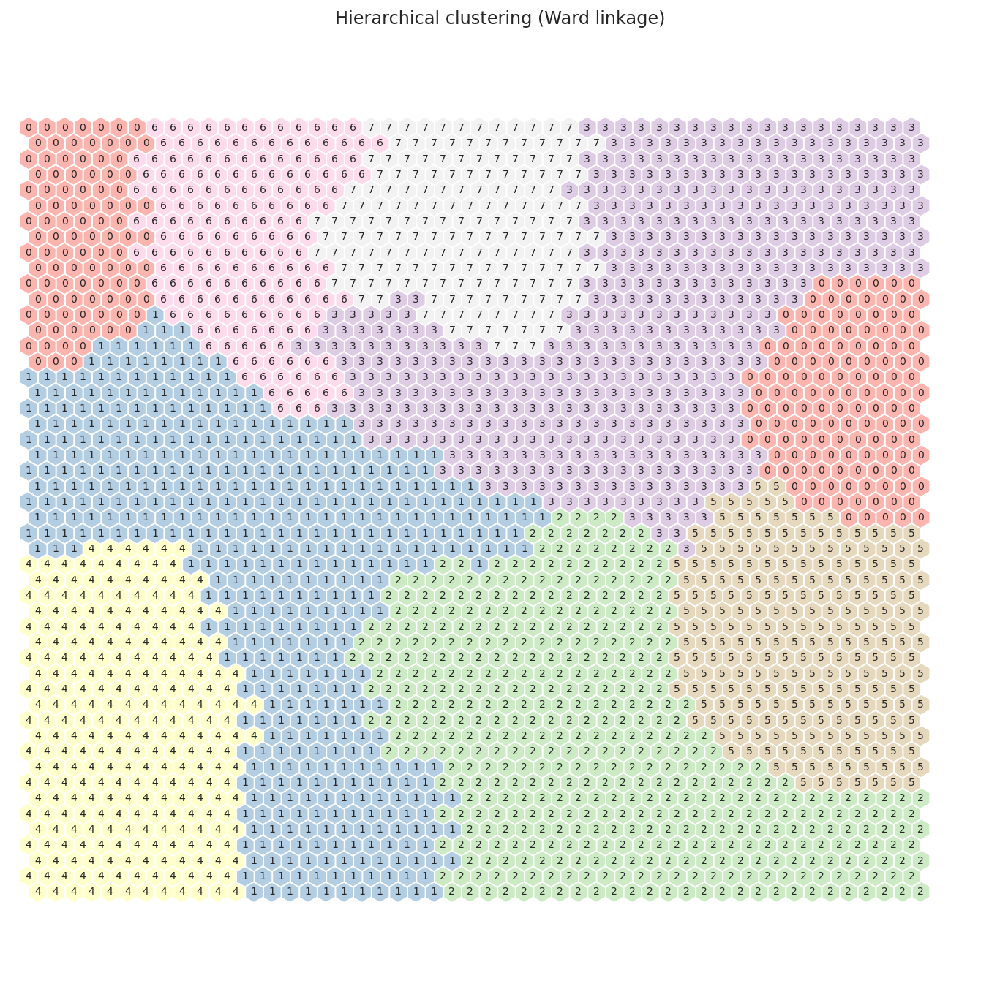

In [83]:
hits  = HitMapView(12, 12, "Hierarchical clustering (Ward linkage)", text_size=10)
hits.show(som, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")
plt.show()

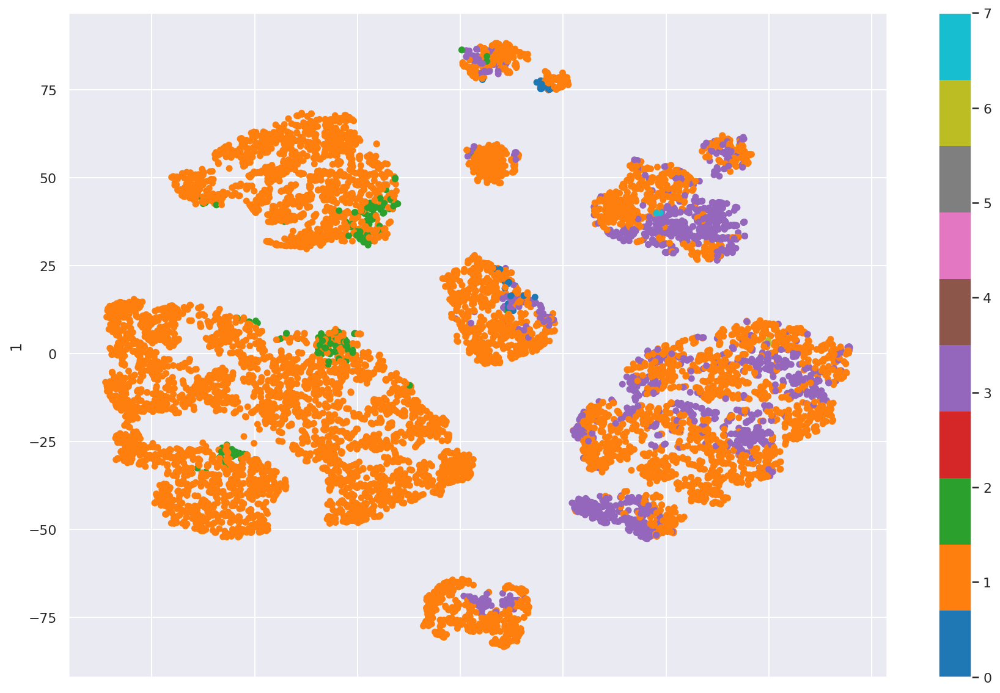

In [84]:
pd.DataFrame(two_dim_tsne).plot.scatter(x=0, y=1, c=labels_som_aggl_ward, colormap="tab10", figsize=(15, 10))
plt.show()

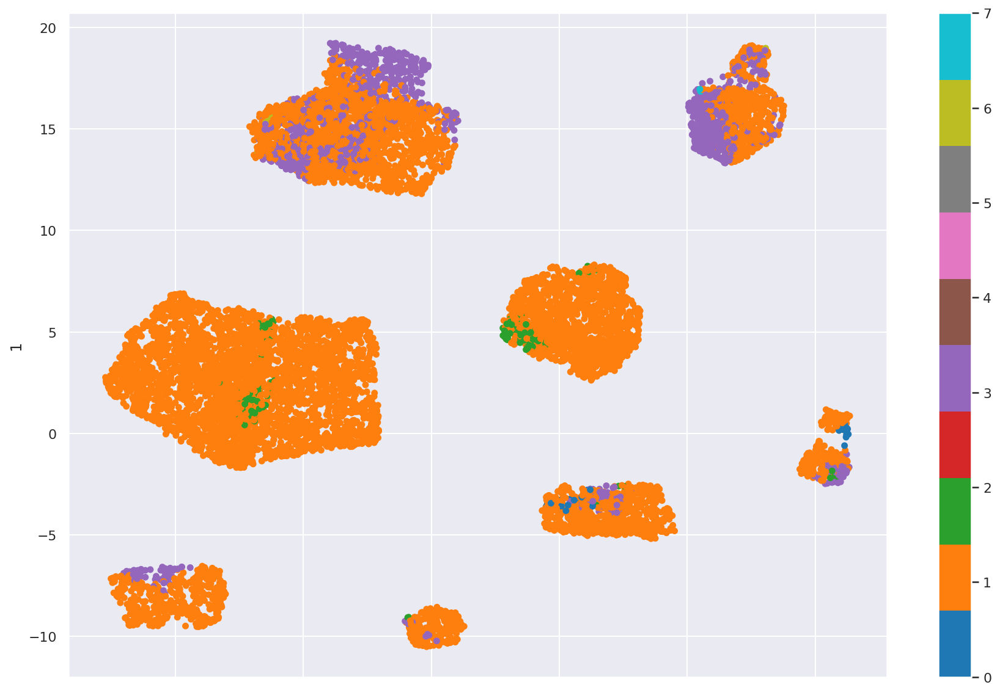

In [85]:
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=labels_som_aggl_ward, colormap="tab10", figsize=(15, 10))
plt.show()

## Selection

In [86]:
labels = labels_aggl_ward

# Interpretation

## Decision tree

In [87]:
tree = DecisionTreeClassifier().fit(data, labels)
score = tree.score(data, labels)
print("Score:", score)

Score: 1.0


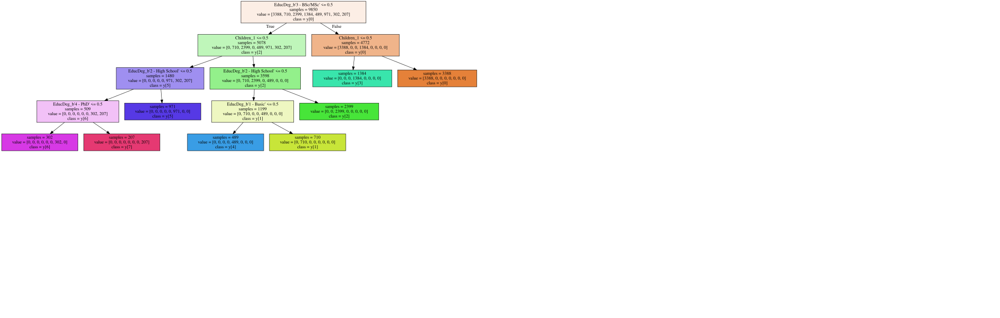

In [89]:
dot_data = export_graphviz(tree, feature_names=data.columns, class_names=True, filled=True, impurity=False)
pydot_graph = pydotplus.graph_from_dot_data(dot_data)
pydot_graph.set_size('"30,30!"')
graphviz.Source(pydot_graph.to_string())